In [1]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'  # or any {'0', '1', '2'}
# 0: infos, warning, errors.
# 1: warnings, errors.
# 2: errors.
# 3: none.
import tensorflow as tf
physical_devices = tf.config.list_physical_devices('GPU')
print("GPUs available:", physical_devices)
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)

GPUs available: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [2]:
from functools import partial
import math
import numpy as np
import random

from ocml.datasets import build_ds, tfds_from_sampler, tf_from_tfds, zip_ds, preprocess_cifar10
from ocml.evaluate import check_LLC, log_metrics
from ocml.models import spectral_VGG, spectral_VGG_V2
from ocml.plot import plot_preds_ood, plot_imgs_grid, plot_gan
from ocml.priors import uniform_image, augment_cifar10, Cifar10_NDA
from ocml.train import train, SH_KR

Perlin noise not available. Please install perlin_numpy package with `pip3 install git+https://github.com/pvigier/perlin-numpy`.


In [3]:
from types import SimpleNamespace
import math


def perc_to_margin(img_size, num_channels, perc, domain):
    return perc * (img_size * img_size * num_channels * (domain[1] - domain[0]))**0.5

def get_config(debug=False):
  domain = [-2, 2.]  # required for images.
  # heuristic of https://arxiv.org/abs/2206.06854
  ratio_images = 0.1 / 100
  ratio_pixels = 0.5 / 100
  margin = perc_to_margin(32, 3, ratio_pixels, domain)
  lbda = 1. / ratio_images  
  print(f"Margin={margin:.3f} Lambda={lbda:.3f}")
  dataset_name = os.environ.get("DATASET_NAME", "cifar10")
  config = SimpleNamespace(
    dataset_name = dataset_name,
    # Newton-Raphson.
    maxiter = 40,
    eta = 20.,
    level_set = -margin,
    batch_size = 128,
    domain = domain,
    margin = margin,
    lbda = lbda,
    domain_clip = True,
    deterministic = False,
    negative_augmentation = False,
    overshoot_boundary = True,
    # architecture.
    k_coef_lip = 1.,
    strides = False,
    spectral_dense = True,
    pooling = True,
    global_pooling = False,
    groupsort = True,
    conv_widths = [256, 256, 256],
    dense_widths = [256, 256, 256],
    # training.
    in_labels = [0],
    warmup_epochs = 10,
    epochs_per_plot = 40,
  )
  return config

In [4]:
debug = "SANDBOX" in os.environ
config = get_config(debug)
train_kwargs = {
  'domain': config.domain,
  'eta': config.eta,
  'deterministic': config.deterministic,
  'level_set': config.level_set,
  'overshoot_boundary': config.overshoot_boundary
}

Margin=0.554 Lambda=1000.000


In [5]:
import plotly.io as pio
print("PLOTLY_RENDERER:", pio.renderers.default)
try:
  import wandb
  wandb.login()
  wandb_available = True
except ModuleNotFoundError as e:
  print(e)
  print("Wandb logs will be removed.")
  wandb_available = False
plot_wandb = wandb_available and not debug  # Set to False to de-activate Wandb.
if plot_wandb:
  import wandb
  group = os.environ.get("WANDB_GROUP", "sandbox_cifar10")
  wandb.init(project="ocml_cifar10", config=config.__dict__, group=group, save_code=True)
else:
  try:
    wandb.finish()
  except Exception as e:
    print(e)

train_kwargs['log_metrics_fn'] = partial(log_metrics, plot_wandb=plot_wandb)

PLOTLY_RENDERER: plotly_mimetype+notebook


Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: algue (use `wandb login --relogin` to force relogin)
wandb: wandb version 0.13.7 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


In [6]:
input_shape = (32, 32, 3)
model = spectral_VGG_V2(input_shape, k_coef_lip=config.k_coef_lip, scale=1)

loss_fn = SH_KR(config.margin, config.lbda)

In [7]:
build_ds = partial(build_ds, preprocess_fun=preprocess_cifar10)

In [8]:
# Produce and process dataset.
p_dataset = build_ds(config.dataset_name, config.batch_size, in_labels=config.in_labels, domain=config.domain)
num_images = 50 * 1000
epoch_length = math.ceil(num_images*len(config.in_labels)*(1/10) / config.batch_size) if not debug else 3

In [9]:
X_P = tf.reshape(tf_from_tfds(p_dataset.take(epoch_length)), shape=(-1,)+input_shape)
p_dataset = augment_cifar10(p_dataset)
X_test = tf_from_tfds(build_ds(config.dataset_name, config.batch_size, in_labels=config.in_labels, domain=config.domain, split='test'))
X_ood = tf_from_tfds(build_ds(config.dataset_name, config.batch_size, in_labels=config.in_labels, domain=config.domain, split='ood'))
print(f'TrainSize={len(X_P)} TestSize={len(X_test)} OODSize={len(X_ood)}')

TrainSize=5120 TestSize=1000 OODSize=9000


In [10]:
# Create optimizer class.
blocks = 4
decay_steps = epoch_length*(config.warmup_epochs + config.epochs_per_plot*blocks)
initial_learning_rate = 2.5e-4
learning_rate =  tf.keras.optimizers.schedules.PolynomialDecay(
    initial_learning_rate=initial_learning_rate, decay_steps=decay_steps,
  end_learning_rate=initial_learning_rate/1000, power=1.)
opt = tf.keras.optimizers.RMSprop(learning_rate=learning_rate)

# Initialize the network.
gen = tf.random.Generator.from_seed(random.randint(0, 1000))
p_batch = next(iter(p_dataset))
_ = model(p_batch, training=True)  # garbage forward.
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
spectral_conv2d (SpectralCon (128, 32, 32, 64)         3585      
_________________________________________________________________
group_sort2 (GroupSort2)     (128, 32, 32, 64)         0         
_________________________________________________________________
spectral_conv2d_1 (SpectralC (128, 32, 32, 64)         73857     
_________________________________________________________________
group_sort2_1 (GroupSort2)   (128, 32, 32, 64)         0         
_________________________________________________________________
spectral_conv2d_2 (SpectralC (128, 32, 32, 64)         73857     
_________________________________________________________________
group_sort2_2 (GroupSort2)   (128, 32, 32, 64)         0         
_________________________________________________________________
spectral_conv2d_3 (SpectralC (128, 32, 32, 64)         7

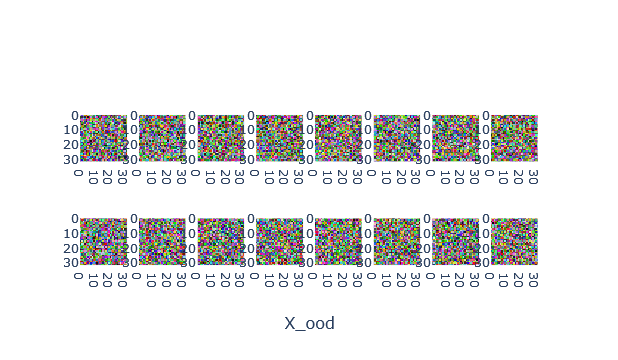

In [11]:
# Adversarial distribution.
if config.negative_augmentation:
  bs_1, bs_2 = config.batch_size // 2, config.batch_size - (config.batch_size // 2)
  q_random = tfds_from_sampler(uniform_image, gen, bs_1, p_batch.shape[1:], domain=config.domain)
  q_nda = Cifar10_NDA(bs_1, p_batch.shape[1:]).transform(gen, build_mnist(config.dataset_name, bs_2, in_labels=config.in_labels))
  q_dataset = zip_ds(q_random, q_nda)
else:
  q_dataset = tfds_from_sampler(uniform_image, gen, config.batch_size, p_batch.shape[1:], domain=config.domain)
Q0 = next(iter(q_dataset))
plot_imgs_grid(Q0, 'X_ood.png')

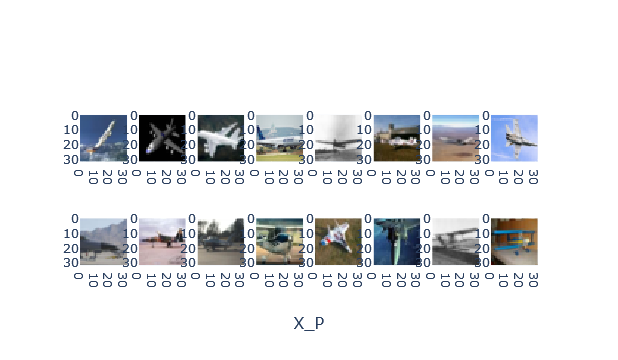

In [12]:
# plot_imgs_grid(X_test, 'X_test.png')
# plot_imgs_grid(X_ood, 'X_ood.png')
# check_LLC(model, Q0, plot_wandb)
plot_imgs_grid(X_P, 'X_P.png')

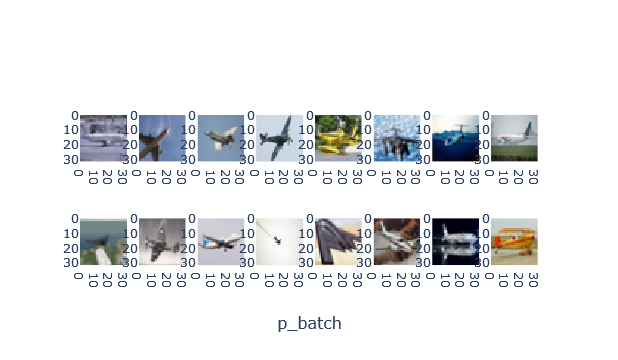

In [13]:
plot_imgs_grid(p_batch, 'p_batch.png')

Epoch=0 LR=0.0002500


100%|██████████| 40/40 [00:59<00:00,  1.49s/it, FP=0.00%, GN_Qt=0.000, P=2.603, Q0=-0.729, Qt=-0.729, R=1.00%, lipschitz_ratio=1.000, loss=0.247] 


Epoch=1 LR=0.0002485


100%|██████████| 40/40 [00:11<00:00,  3.52it/s, FP=0.00%, GN_Qt=0.000, P=3.536, Q0=-1.060, Qt=-1.060, R=1.00%, lipschitz_ratio=1.000, loss=0.011] 


Epoch=2 LR=0.0002471


100%|██████████| 40/40 [00:11<00:00,  3.55it/s, FP=0.00%, GN_Qt=0.000, P=5.968, Q0=-0.900, Qt=-0.900, R=1.00%, lipschitz_ratio=1.000, loss=-0.005]


Epoch=3 LR=0.0002456


100%|██████████| 40/40 [00:11<00:00,  3.35it/s, FP=0.00%, GN_Qt=0.000, P=12.873, Q0=-1.594, Qt=-1.594, R=1.00%, lipschitz_ratio=1.000, loss=-0.010]


Epoch=4 LR=0.0002441


100%|██████████| 40/40 [00:12<00:00,  3.31it/s, FP=0.00%, GN_Qt=0.000, P=23.152, Q0=-1.802, Qt=-1.802, R=1.00%, lipschitz_ratio=1.000, loss=-0.017]


Epoch=5 LR=0.0002427


100%|██████████| 40/40 [00:12<00:00,  3.31it/s, FP=0.00%, GN_Qt=0.000, P=24.095, Q0=-2.857, Qt=-2.857, R=1.00%, lipschitz_ratio=1.000, loss=-0.022]


Epoch=6 LR=0.0002412


100%|██████████| 40/40 [00:12<00:00,  3.29it/s, FP=0.00%, GN_Qt=0.000, P=29.590, Q0=-2.459, Qt=-2.459, R=1.00%, lipschitz_ratio=1.000, loss=-0.030]


Epoch=7 LR=0.0002397


100%|██████████| 40/40 [00:12<00:00,  3.26it/s, FP=0.00%, GN_Qt=0.000, P=33.811, Q0=-3.955, Qt=-3.955, R=1.00%, lipschitz_ratio=1.000, loss=-0.035]


Epoch=8 LR=0.0002382


100%|██████████| 40/40 [00:12<00:00,  3.25it/s, FP=0.00%, GN_Qt=0.000, P=36.465, Q0=-4.177, Qt=-4.177, R=1.00%, lipschitz_ratio=1.000, loss=-0.039]


Epoch=9 LR=0.0002368


100%|██████████| 40/40 [00:12<00:00,  3.23it/s, FP=0.00%, GN_Qt=0.000, P=38.073, Q0=-3.290, Qt=-3.290, R=1.00%, lipschitz_ratio=1.000, loss=-0.041]


36/36 [==============================] - 12s 338ms/step
Train examples DescribeResult(nobs=5120, minmax=(4.879909, 110.688156), mean=39.829082, variance=262.4577, skewness=0.7110608816146851, kurtosis=0.3189860605223158)
Test examples DescribeResult(nobs=1000, minmax=(7.094587, 110.29641), mean=40.325348, variance=278.99738, skewness=0.7634637951850891, kurtosis=0.3720094180110234)
OOD examples DescribeResult(nobs=9000, minmax=(5.059321, 95.84917), mean=33.920315, variance=150.09004, skewness=0.6328199505805969, kurtosis=0.6111414061540597)
[train/ood] Avg Dist=5.909 T=53.590 Acc=66.53%
[train/ood] AUROC =60.121
[test /ood] Avg Dist =6.405033111572266 T=82.693 Acc=90.12%
[test /ood] AUROC =60.502


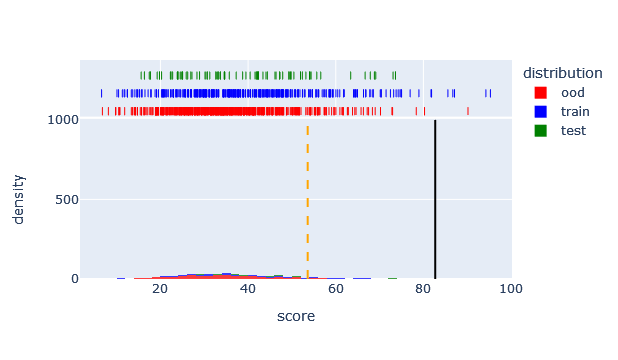

1/1 [==============================] - 0s 37ms/step
P=38.511024475097656 y_Q0=-3.63327693939209  y_Qt=-0.8730489015579224 y_Qinf=35.60704803466797


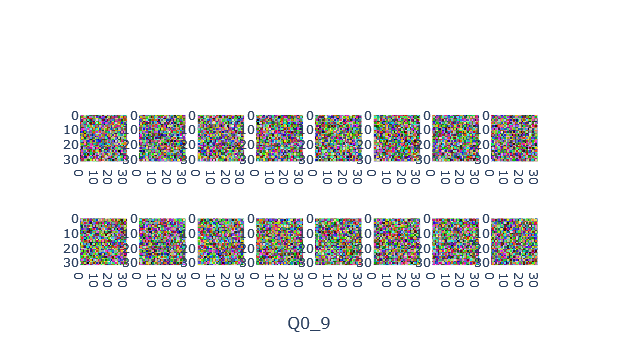

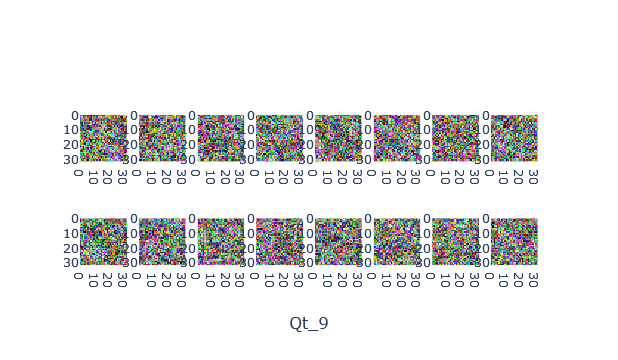

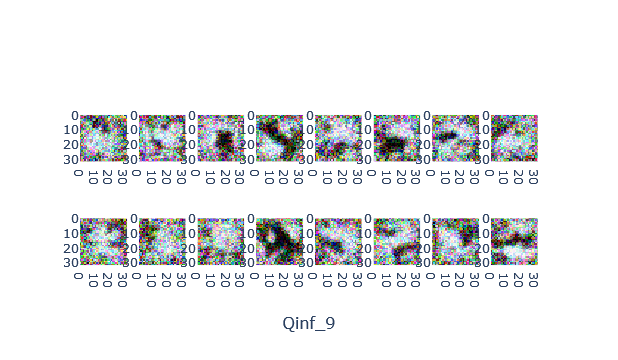

In [14]:
epoch = 0
for epoch in range(0, config.warmup_epochs):
  print(f"Epoch={epoch} LR={float(opt._decayed_lr(tf.float32)):.7f}")
  train(model, opt, loss_fn, gen, p_dataset, q_dataset, epoch_length, maxiter=0, **train_kwargs)
plot_preds_ood(epoch, model, X_P, X_test, X_ood, plot_histogram=True, plot_wandb=plot_wandb)
plot_gan(epoch, model, p_batch, Q0[:16], gen, maxiter=config.maxiter, **train_kwargs)

Epoch=10 LR=0.0002353


100%|██████████| 40/40 [02:18<00:00,  3.47s/it, FP=0.00%, GN_Qt=0.357, P=9.683, Q0=-10.811, Qt=-1.063, R=0.98%, lipschitz_ratio=1.906, loss=0.537] 


36/36 [==============================] - 2s 44ms/step
Train examples DescribeResult(nobs=5120, minmax=(-9.842597, 29.412561), mean=4.414727, variance=25.434668, skewness=0.9397991299629211, kurtosis=0.810085173608706)
Test examples DescribeResult(nobs=1000, minmax=(-4.3528204, 28.937115), mean=4.6974955, variance=27.023705, skewness=0.9296247959136963, kurtosis=0.8013878456035699)
OOD examples DescribeResult(nobs=9000, minmax=(-5.8934436, 23.90947), mean=1.5179635, variance=12.548514, skewness=1.2382031679153442, kurtosis=2.240547557538611)
[train/ood] Avg Dist=2.897 T=5.232 Acc=68.78%
[train/ood] AUROC =67.897
[test /ood] Avg Dist =3.179532051086426 T=16.683 Acc=90.13%
[test /ood] AUROC =69.065
Epoch=11 LR=0.0002338


100%|██████████| 40/40 [01:27<00:00,  2.18s/it, FP=0.00%, GN_Qt=0.256, P=7.498, Q0=-10.318, Qt=-0.934, R=0.99%, lipschitz_ratio=2.069, loss=0.159] 


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-7.5444613, 27.532534), mean=4.383502, variance=20.04097, skewness=1.0676190853118896, kurtosis=1.12523344389969)
Test examples DescribeResult(nobs=1000, minmax=(-2.8669379, 27.064339), mean=4.65514, variance=21.445042, skewness=1.0445985794067383, kurtosis=1.119639692307132)
OOD examples DescribeResult(nobs=9000, minmax=(-3.969382, 22.41739), mean=1.6889533, variance=9.387426, skewness=1.4926443099975586, kurtosis=3.0862565386531164)
[train/ood] Avg Dist=2.695 T=5.166 Acc=69.08%
[train/ood] AUROC =69.465
[test /ood] Avg Dist =2.9661865234375 T=14.612 Acc=90.12%
[test /ood] AUROC =70.742
Epoch=12 LR=0.0002324


100%|██████████| 40/40 [01:27<00:00,  2.19s/it, FP=0.00%, GN_Qt=0.258, P=8.293, Q0=-8.977, Qt=-1.155, R=1.00%, lipschitz_ratio=2.122, loss=0.072] 

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-4.011021, 37.673965), mean=9.33906, variance=31.225397, skewness=0.9692960977554321, kurtosis=1.0050782374308405)
Test examples DescribeResult(nobs=1000, minmax=(-0.051349353, 37.217094), mean=9.600806, variance=33.53391, skewness=0.9902908802032471, kurtosis=1.069234021638982)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7973222, 31.32077), mean=6.392071, variance=16.718557, skewness=1.0190012454986572, kurtosis=1.6234905246961162)
[train/ood] Avg Dist=2.947 T=11.905 Acc=67.68%
[train/ood] AUROC =66.087
[test /ood] Avg Dist =3.208735466003418 T=24.334 Acc=90.13%
[test /ood] AUROC =66.981
Epoch=13 LR=0.0002309


100%|██████████| 40/40 [01:28<00:00,  2.20s/it, FP=0.00%, GN_Qt=0.198, P=5.910, Q0=-6.492, Qt=-1.050, R=0.95%, lipschitz_ratio=2.647, loss=0.054] 

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-2.5579224, 30.812908), mean=7.0446806, variance=22.01218, skewness=0.9524036049842834, kurtosis=0.9575842181507124)
Test examples DescribeResult(nobs=1000, minmax=(-0.7319619, 30.400808), mean=7.2753353, variance=23.690144, skewness=0.9617444276809692, kurtosis=1.0095763087849248)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7653588, 25.384968), mean=4.3842583, variance=11.742961, skewness=1.078604817390442, kurtosis=1.7135550897405247)
[train/ood] Avg Dist=2.660 T=8.389 Acc=68.10%
[train/ood] AUROC =67.560
[test /ood] Avg Dist =2.8910770416259766 T=16.730 Acc=90.12%
[test /ood] AUROC =68.490
Epoch=14 LR=0.0002294


100%|██████████| 40/40 [01:28<00:00,  2.20s/it, FP=0.00%, GN_Qt=0.246, P=4.138, Q0=-5.368, Qt=-0.701, R=0.73%, lipschitz_ratio=3.093, loss=0.083]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.4210128, 29.427536), mean=6.198962, variance=22.391256, skewness=0.9432483315467834, kurtosis=0.8037005261650294)
Test examples DescribeResult(nobs=1000, minmax=(-0.8337242, 29.094225), mean=6.4323635, variance=24.201397, skewness=0.9351694583892822, kurtosis=0.8127912343893997)
OOD examples DescribeResult(nobs=9000, minmax=(-1.1646203, 24.111555), mean=3.4265943, variance=11.416249, skewness=1.2401119470596313, kurtosis=1.9965278691967736)
[train/ood] Avg Dist=2.772 T=6.949 Acc=68.53%
[train/ood] AUROC =68.397
[test /ood] Avg Dist =3.0057692527770996 T=18.832 Acc=90.15%
[test /ood] AUROC =69.234
Epoch=15 LR=0.0002280


100%|██████████| 40/40 [01:28<00:00,  2.20s/it, FP=1.00%, GN_Qt=0.017, P=4.638, Q0=0.208, Qt=0.208, R=0.91%, lipschitz_ratio=0.000, loss=0.168]  


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.6537373, 28.960772), mean=6.3411036, variance=21.985596, skewness=0.8743494749069214, kurtosis=0.6924266380406308)
Test examples DescribeResult(nobs=1000, minmax=(-1.0046979, 28.639095), mean=6.5737863, variance=23.658596, skewness=0.8744732737541199, kurtosis=0.7223270409472073)
OOD examples DescribeResult(nobs=9000, minmax=(-1.559707, 23.763048), mean=3.427319, variance=11.724632, skewness=1.1527317762374878, kurtosis=1.6867344695531736)
[train/ood] Avg Dist=2.914 T=7.012 Acc=68.81%
[train/ood] AUROC =69.444
[test /ood] Avg Dist =3.1464672088623047 T=18.658 Acc=90.15%
[test /ood] AUROC =70.323
Epoch=16 LR=0.0002265


100%|██████████| 40/40 [01:27<00:00,  2.20s/it, FP=0.00%, GN_Qt=0.185, P=7.002, Q0=-4.221, Qt=-0.733, R=0.99%, lipschitz_ratio=3.347, loss=0.068]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.3049786, 29.730864), mean=6.8120294, variance=21.708727, skewness=0.8912261128425598, kurtosis=0.7994266029945343)
Test examples DescribeResult(nobs=1000, minmax=(-0.7908762, 29.412502), mean=7.018254, variance=23.44255, skewness=0.902479350566864, kurtosis=0.8537313864771927)
OOD examples DescribeResult(nobs=9000, minmax=(-1.2746496, 24.426634), mean=4.1615143, variance=11.913737, skewness=1.0288046598434448, kurtosis=1.4333685363411561)
[train/ood] Avg Dist=2.651 T=8.698 Acc=68.02%
[train/ood] AUROC =67.535
[test /ood] Avg Dist =2.8567395210266113 T=16.641 Acc=90.13%
[test /ood] AUROC =68.285
Epoch=17 LR=0.0002250


100%|██████████| 40/40 [01:27<00:00,  2.20s/it, FP=0.00%, GN_Qt=0.077, P=5.859, Q0=-2.320, Qt=-0.613, R=0.95%, lipschitz_ratio=4.687, loss=0.109]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 44ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.8435395, 30.11719), mean=7.1150346, variance=23.435823, skewness=0.8416970372200012, kurtosis=0.6322275633307459)
Test examples DescribeResult(nobs=1000, minmax=(-0.7323858, 29.786825), mean=7.348621, variance=25.241734, skewness=0.8389877676963806, kurtosis=0.6567322792937507)
OOD examples DescribeResult(nobs=9000, minmax=(-0.84943664, 24.929996), mean=4.122521, variance=12.765687, skewness=1.0861023664474487, kurtosis=1.4978749384580317)
[train/ood] Avg Dist=2.993 T=7.711 Acc=68.68%
[train/ood] AUROC =69.202
[test /ood] Avg Dist =3.226099967956543 T=16.934 Acc=90.15%
[test /ood] AUROC =70.039
Epoch=18 LR=0.0002236


100%|██████████| 40/40 [01:27<00:00,  2.19s/it, FP=0.00%, GN_Qt=0.202, P=6.249, Q0=-3.442, Qt=-0.674, R=0.98%, lipschitz_ratio=3.832, loss=0.073]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.2813951, 26.677238), mean=6.2914133, variance=17.714684, skewness=0.7886865139007568, kurtosis=0.620172926934206)
Test examples DescribeResult(nobs=1000, minmax=(-0.9885126, 26.372995), mean=6.432037, variance=18.961708, skewness=0.8237593770027161, kurtosis=0.7284148963158814)
OOD examples DescribeResult(nobs=9000, minmax=(-1.393162, 21.715345), mean=4.044969, variance=10.976867, skewness=0.8373425602912903, kurtosis=0.8224141824710287)
[train/ood] Avg Dist=2.246 T=9.346 Acc=66.85%
[train/ood] AUROC =66.081
[test /ood] Avg Dist =2.3870677947998047 T=16.608 Acc=90.08%
[test /ood] AUROC =66.581
Epoch=19 LR=0.0002221


100%|██████████| 40/40 [01:27<00:00,  2.20s/it, FP=0.00%, GN_Qt=0.101, P=4.744, Q0=-2.478, Qt=-0.614, R=0.89%, lipschitz_ratio=4.748, loss=0.086]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.8593144, 29.110971), mean=7.467098, variance=20.806074, skewness=0.756037712097168, kurtosis=0.5488081288446192)
Test examples DescribeResult(nobs=1000, minmax=(-0.78930086, 28.822876), mean=7.617549, variance=22.257698, skewness=0.7911372780799866, kurtosis=0.6466594909821808)
OOD examples DescribeResult(nobs=9000, minmax=(-0.934177, 23.887245), mean=4.9759803, variance=13.062372, skewness=0.7996034026145935, kurtosis=0.7458917389761508)
[train/ood] Avg Dist=2.491 T=9.853 Acc=67.01%
[train/ood] AUROC =66.405
[test /ood] Avg Dist =2.641568660736084 T=18.334 Acc=90.09%
[test /ood] AUROC =66.884
Epoch=20 LR=0.0002206


100%|██████████| 40/40 [01:27<00:00,  2.20s/it, FP=0.00%, GN_Qt=0.186, P=7.194, Q0=-3.221, Qt=-0.661, R=0.98%, lipschitz_ratio=3.968, loss=0.064]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.1052023, 29.558775), mean=6.8787293, variance=22.448708, skewness=0.8256712555885315, kurtosis=0.6260851869922281)
Test examples DescribeResult(nobs=1000, minmax=(-0.9530386, 29.23541), mean=7.0562067, variance=24.22352, skewness=0.8425997495651245, kurtosis=0.6851079735603873)
OOD examples DescribeResult(nobs=9000, minmax=(-1.2853127, 24.232082), mean=4.1761794, variance=12.968898, skewness=0.9595507979393005, kurtosis=1.1142687207365594)
[train/ood] Avg Dist=2.703 T=9.133 Acc=67.68%
[train/ood] AUROC =67.442
[test /ood] Avg Dist =2.8800272941589355 T=19.182 Acc=90.15%
[test /ood] AUROC =67.965
Epoch=21 LR=0.0002191


100%|██████████| 40/40 [01:27<00:00,  2.20s/it, FP=0.00%, GN_Qt=0.187, P=6.939, Q0=-3.409, Qt=-0.637, R=0.97%, lipschitz_ratio=3.929, loss=0.073]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.1230794, 27.51011), mean=6.5277877, variance=18.867184, skewness=0.7956556677818298, kurtosis=0.6314777009066885)
Test examples DescribeResult(nobs=1000, minmax=(-0.9713305, 27.233583), mean=6.6579933, variance=20.216318, skewness=0.8332488536834717, kurtosis=0.7453654743906251)
OOD examples DescribeResult(nobs=9000, minmax=(-1.2710396, 22.379593), mean=4.209448, variance=11.852156, skewness=0.8526275157928467, kurtosis=0.8412345230729228)
[train/ood] Avg Dist=2.318 T=8.739 Acc=66.74%
[train/ood] AUROC =66.110
[test /ood] Avg Dist =2.448545455932617 T=16.864 Acc=90.09%
[test /ood] AUROC =66.488
Epoch=22 LR=0.0002177


100%|██████████| 40/40 [01:27<00:00,  2.20s/it, FP=0.00%, GN_Qt=0.209, P=5.377, Q0=-5.245, Qt=-0.653, R=0.91%, lipschitz_ratio=3.215, loss=0.055]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.4194641, 20.677217), mean=3.6939132, variance=11.1571455, skewness=0.9398340582847595, kurtosis=0.8933442910115801)
Test examples DescribeResult(nobs=1000, minmax=(-1.2003707, 20.368347), mean=3.749429, variance=11.786614, skewness=0.9787039160728455, kurtosis=1.0246018322096173)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7424375, 17.606508), mean=2.1921232, variance=7.4736595, skewness=1.1006320714950562, kurtosis=1.4400882482954067)
[train/ood] Avg Dist=1.502 T=6.837 Acc=65.58%
[train/ood] AUROC =63.858
[test /ood] Avg Dist =1.5573058128356934 T=17.607 Acc=90.00%
[test /ood] AUROC =63.949
Epoch=23 LR=0.0002162


100%|██████████| 40/40 [01:27<00:00,  2.20s/it, FP=0.00%, GN_Qt=0.214, P=6.634, Q0=-4.016, Qt=-0.723, R=0.98%, lipschitz_ratio=3.578, loss=0.074]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.4075645, 23.54012), mean=4.42047, variance=14.74247, skewness=0.912534236907959, kurtosis=0.8052685156533328)
Test examples DescribeResult(nobs=1000, minmax=(-1.3362291, 23.253267), mean=4.541757, variance=15.862235, skewness=0.9371127486228943, kurtosis=0.9035832053120645)
OOD examples DescribeResult(nobs=9000, minmax=(-1.6545428, 18.926085), mean=2.3328109, variance=8.6101, skewness=1.0890209674835205, kurtosis=1.3446299888420103)
[train/ood] Avg Dist=2.088 T=5.890 Acc=66.98%
[train/ood] AUROC =66.865
[test /ood] Avg Dist =2.2089462280273438 T=14.330 Acc=90.09%
[test /ood] AUROC =67.226
Epoch=24 LR=0.0002147


100%|██████████| 40/40 [01:27<00:00,  2.20s/it, FP=0.00%, GN_Qt=0.179, P=6.640, Q0=-3.594, Qt=-0.664, R=0.98%, lipschitz_ratio=3.824, loss=0.062]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.4066131, 21.832167), mean=4.4161654, variance=12.524888, skewness=0.8451753258705139, kurtosis=0.7270011534720342)
Test examples DescribeResult(nobs=1000, minmax=(-1.3187871, 21.56391), mean=4.496838, variance=13.298959, skewness=0.8845444321632385, kurtosis=0.8569763637058148)
OOD examples DescribeResult(nobs=9000, minmax=(-1.6342249, 17.641853), mean=2.6331377, variance=8.321245, skewness=0.950649619102478, kurtosis=1.0329582852854111)
[train/ood] Avg Dist=1.783 T=7.764 Acc=66.08%
[train/ood] AUROC =65.332
[test /ood] Avg Dist =1.8637003898620605 T=13.126 Acc=90.01%
[test /ood] AUROC =65.570
Epoch=25 LR=0.0002133


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.160, P=5.229, Q0=-3.370, Qt=-0.706, R=0.98%, lipschitz_ratio=3.930, loss=0.058]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.1695484, 24.31859), mean=5.87725, variance=14.527647, skewness=0.8063467741012573, kurtosis=0.6701673360017706)
Test examples DescribeResult(nobs=1000, minmax=(-0.8331971, 24.054558), mean=6.030043, variance=15.670909, skewness=0.8157932162284851, kurtosis=0.7325499981995582)
OOD examples DescribeResult(nobs=9000, minmax=(-1.3493775, 20.018824), mean=3.499305, variance=8.631033, skewness=0.9543024301528931, kurtosis=1.1560722285233238)
[train/ood] Avg Dist=2.378 T=6.832 Acc=68.16%
[train/ood] AUROC =69.168
[test /ood] Avg Dist =2.530738115310669 T=15.667 Acc=90.13%
[test /ood] AUROC =69.758
Epoch=27 LR=0.0002103


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.106, P=3.805, Q0=-2.602, Qt=-0.671, R=0.92%, lipschitz_ratio=4.559, loss=0.081]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.005026, 20.873209), mean=5.0614567, variance=10.701732, skewness=0.7993265390396118, kurtosis=0.6750586397924785)
Test examples DescribeResult(nobs=1000, minmax=(-0.7695106, 20.678223), mean=5.1934986, variance=11.538797, skewness=0.8093734979629517, kurtosis=0.7439950381841531)
OOD examples DescribeResult(nobs=9000, minmax=(-1.1130091, 17.111067), mean=2.9665186, variance=6.424022, skewness=0.9344569444656372, kurtosis=1.0906666503649154)
[train/ood] Avg Dist=2.095 T=5.763 Acc=68.19%
[train/ood] AUROC =69.643
[test /ood] Avg Dist =2.226979970932007 T=13.506 Acc=90.14%
[test /ood] AUROC =70.239
Epoch=28 LR=0.0002089


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.220, P=5.607, Q0=-3.303, Qt=-0.601, R=0.99%, lipschitz_ratio=4.049, loss=0.034]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.2424133, 18.372925), mean=4.0330896, variance=8.208046, skewness=0.836193323135376, kurtosis=0.8090193215463564)
Test examples DescribeResult(nobs=1000, minmax=(-0.98525614, 18.162247), mean=4.161608, variance=8.875055, skewness=0.835121214389801, kurtosis=0.863083576594998)
OOD examples DescribeResult(nobs=9000, minmax=(-1.4124392, 14.871397), mean=2.0382395, variance=4.617376, skewness=1.0565866231918335, kurtosis=1.5068470301277852)
[train/ood] Avg Dist=1.995 T=4.834 Acc=69.33%
[train/ood] AUROC =71.686
[test /ood] Avg Dist =2.123368740081787 T=10.770 Acc=90.14%
[test /ood] AUROC =72.323
Epoch=29 LR=0.0002074


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.165, P=2.955, Q0=-2.996, Qt=-0.637, R=0.98%, lipschitz_ratio=4.369, loss=0.069]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.92915505, 16.381195), mean=4.44583, variance=5.9380336, skewness=0.7102625370025635, kurtosis=0.6106373424214362)
Test examples DescribeResult(nobs=1000, minmax=(-0.33622715, 16.220396), mean=4.5412436, variance=6.3390117, skewness=0.7339282035827637, kurtosis=0.7116115902572946)
OOD examples DescribeResult(nobs=9000, minmax=(-1.3369887, 13.351975), mean=2.6950629, variance=3.7266927, skewness=0.8911192417144775, kurtosis=1.1367732138577695)
[train/ood] Avg Dist=1.751 T=4.834 Acc=69.13%
[train/ood] AUROC =71.860
[test /ood] Avg Dist =1.8461806774139404 T=10.089 Acc=90.14%
[test /ood] AUROC =72.421
Epoch=30 LR=0.0002059


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.122, P=2.291, Q0=-3.158, Qt=-0.687, R=0.89%, lipschitz_ratio=4.357, loss=0.056]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 44ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.2579207, 16.63922), mean=3.7376823, variance=6.8135257, skewness=0.7923499941825867, kurtosis=0.725924102682574)
Test examples DescribeResult(nobs=1000, minmax=(-0.9923248, 16.472715), mean=3.8394272, variance=7.343853, skewness=0.798565149307251, kurtosis=0.7957858085156277)
OOD examples DescribeResult(nobs=9000, minmax=(-1.41846, 13.460826), mean=1.9251771, variance=4.1297655, skewness=0.9810325503349304, kurtosis=1.2476320913405061)
[train/ood] Avg Dist=1.813 T=4.267 Acc=68.82%
[train/ood] AUROC =71.380
[test /ood] Avg Dist =1.914250135421753 T=9.831 Acc=90.11%
[test /ood] AUROC =71.878
Epoch=31 LR=0.0002045


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.170, P=4.474, Q0=-2.995, Qt=-0.712, R=0.99%, lipschitz_ratio=4.251, loss=0.036]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.4938287, 13.785377), mean=2.8764198, variance=4.8377857, skewness=0.6992940306663513, kurtosis=0.6099855908963892)
Test examples DescribeResult(nobs=1000, minmax=(-1.239, 13.550353), mean=2.960389, variance=5.147434, skewness=0.7045954465866089, kurtosis=0.6875138299572061)
OOD examples DescribeResult(nobs=9000, minmax=(-1.649063, 10.960331), mean=1.2449766, variance=3.072686, skewness=0.9751619696617126, kurtosis=1.2348085826236872)
[train/ood] Avg Dist=1.631 T=3.050 Acc=69.40%
[train/ood] AUROC =72.587
[test /ood] Avg Dist =1.7154122591018677 T=7.702 Acc=90.10%
[test /ood] AUROC =73.134
Epoch=32 LR=0.0002030


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.207, P=4.056, Q0=-3.017, Qt=-0.646, R=0.98%, lipschitz_ratio=4.174, loss=0.038]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.3887691, 13.01144), mean=2.5652533, variance=4.3691993, skewness=0.7264581322669983, kurtosis=0.6642426322126873)
Test examples DescribeResult(nobs=1000, minmax=(-1.1874734, 12.808684), mean=2.634467, variance=4.631232, skewness=0.7304059267044067, kurtosis=0.734517640284932)
OOD examples DescribeResult(nobs=9000, minmax=(-1.5124677, 10.890159), mean=1.0492043, variance=2.881305, skewness=1.0412838459014893, kurtosis=1.3827336144106175)
[train/ood] Avg Dist=1.516 T=2.815 Acc=68.89%
[train/ood] AUROC =72.148
[test /ood] Avg Dist =1.5852625370025635 T=7.258 Acc=90.07%
[test /ood] AUROC =72.587
Epoch=33 LR=0.0002015


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.253, P=2.691, Q0=-3.877, Qt=-0.694, R=0.93%, lipschitz_ratio=3.677, loss=0.045]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.6511042, 15.571219), mean=3.9573524, variance=5.7809997, skewness=0.6439535617828369, kurtosis=0.5138438919973161)
Test examples DescribeResult(nobs=1000, minmax=(-1.0902184, 15.294112), mean=4.0940237, variance=6.1865067, skewness=0.6221408843994141, kurtosis=0.5322410842942524)
OOD examples DescribeResult(nobs=9000, minmax=(-1.8704382, 12.690196), mean=1.8840855, variance=3.3529978, skewness=0.9625211358070374, kurtosis=1.3709075613517543)
[train/ood] Avg Dist=2.073 T=3.574 Acc=72.43%
[train/ood] AUROC =76.145
[test /ood] Avg Dist =2.2099380493164062 T=8.072 Acc=90.26%
[test /ood] AUROC =77.000
Epoch=34 LR=0.0002001


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.176, P=3.683, Q0=-2.908, Qt=-0.683, R=0.99%, lipschitz_ratio=4.359, loss=0.048]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.3263699, 14.94504), mean=3.9942412, variance=4.9510255, skewness=0.6306389570236206, kurtosis=0.5952992827157959)
Test examples DescribeResult(nobs=1000, minmax=(-0.72128904, 14.705213), mean=4.0912724, variance=5.2476406, skewness=0.63909912109375, kurtosis=0.6658061105859612)
OOD examples DescribeResult(nobs=9000, minmax=(-1.6116208, 12.112439), mean=2.2095015, variance=3.227558, skewness=0.8301547169685364, kurtosis=1.0334866032671295)
[train/ood] Avg Dist=1.785 T=3.585 Acc=70.37%
[train/ood] AUROC =74.051
[test /ood] Avg Dist =1.8817708492279053 T=8.322 Acc=90.17%
[test /ood] AUROC =74.740
Epoch=35 LR=0.0001986


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.211, P=1.266, Q0=-3.373, Qt=-0.676, R=0.78%, lipschitz_ratio=4.089, loss=0.043]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.2636815, 12.556439), mean=3.4298775, variance=3.802301, skewness=0.5138522386550903, kurtosis=0.39776972829167834)
Test examples DescribeResult(nobs=1000, minmax=(-0.8056383, 12.38104), mean=3.4974024, variance=3.9654558, skewness=0.5258758664131165, kurtosis=0.4690402823017146)
OOD examples DescribeResult(nobs=9000, minmax=(-1.4402275, 11.3354025), mean=1.8422819, variance=2.8336997, skewness=0.8136741518974304, kurtosis=0.9702459779767136)
[train/ood] Avg Dist=1.588 T=3.447 Acc=70.08%
[train/ood] AUROC =73.821
[test /ood] Avg Dist =1.6551204919815063 T=8.184 Acc=90.07%
[test /ood] AUROC =74.393
Epoch=36 LR=0.0001971


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.169, P=4.045, Q0=-2.767, Qt=-0.647, R=0.99%, lipschitz_ratio=4.427, loss=0.029]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.1387235, 13.8292675), mean=4.01446, variance=4.0513062, skewness=0.5991638898849487, kurtosis=0.5407296806779973)
Test examples DescribeResult(nobs=1000, minmax=(-0.32075194, 13.621783), mean=4.120745, variance=4.3228292, skewness=0.5972827076911926, kurtosis=0.5919566684870166)
OOD examples DescribeResult(nobs=9000, minmax=(-1.4737056, 11.313393), mean=2.21251, variance=2.4706802, skewness=0.8488715887069702, kurtosis=1.1926554590027196)
[train/ood] Avg Dist=1.802 T=3.449 Acc=72.57%
[train/ood] AUROC =76.733
[test /ood] Avg Dist =1.9082350730895996 T=7.091 Acc=90.24%
[test /ood] AUROC =77.526
Epoch=37 LR=0.0001956


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.190, P=4.217, Q0=-2.773, Qt=-0.689, R=0.99%, lipschitz_ratio=4.467, loss=0.035]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.95926195, 13.910004), mean=4.2098045, variance=4.0700374, skewness=0.5318953990936279, kurtosis=0.4442309008102967)
Test examples DescribeResult(nobs=1000, minmax=(-0.24219884, 13.719299), mean=4.2933807, variance=4.288226, skewness=0.5516719222068787, kurtosis=0.5257857490372757)
OOD examples DescribeResult(nobs=9000, minmax=(-1.4476112, 11.268114), mean=2.5045948, variance=2.7836652, skewness=0.7579137086868286, kurtosis=0.931762721586757)
[train/ood] Avg Dist=1.705 T=4.195 Acc=70.98%
[train/ood] AUROC =74.888
[test /ood] Avg Dist =1.7887859344482422 T=7.973 Acc=90.15%
[test /ood] AUROC =75.537
Epoch=38 LR=0.0001942


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.218, P=4.048, Q0=-3.237, Qt=-0.646, R=1.00%, lipschitz_ratio=4.105, loss=0.029]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.7068143, 11.516741), mean=2.3550956, variance=3.4742002, skewness=0.608414351940155, kurtosis=0.5290212981467084)
Test examples DescribeResult(nobs=1000, minmax=(-1.4233896, 11.353568), mean=2.447032, variance=3.701011, skewness=0.6034730672836304, kurtosis=0.5796334598693598)
OOD examples DescribeResult(nobs=9000, minmax=(-1.8225663, 9.1112), mean=0.6972872, variance=2.10184, skewness=0.9426133632659912, kurtosis=1.1643816373997309)
[train/ood] Avg Dist=1.658 T=1.836 Acc=72.31%
[train/ood] AUROC =76.588
[test /ood] Avg Dist =1.7497447729110718 T=5.851 Acc=90.29%
[test /ood] AUROC =77.315
Epoch=39 LR=0.0001927


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.173, P=3.711, Q0=-3.110, Qt=-0.659, R=0.98%, lipschitz_ratio=4.286, loss=0.033]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.5859901, 10.943238), mean=3.1147492, variance=2.989213, skewness=0.38351935148239136, kurtosis=0.3369792734342396)
Test examples DescribeResult(nobs=1000, minmax=(-0.91108894, 10.778269), mean=3.1725166, variance=3.060682, skewness=0.39773011207580566, kurtosis=0.3538939973635862)
OOD examples DescribeResult(nobs=9000, minmax=(-1.8022629, 10.668226), mean=1.6390133, variance=2.3906329, skewness=0.7131020426750183, kurtosis=0.9195098330008888)
[train/ood] Avg Dist=1.476 T=2.939 Acc=70.83%
[train/ood] AUROC =74.464
[test /ood] Avg Dist =1.5335032939910889 T=7.471 Acc=90.02%
[test /ood] AUROC =75.098
Epoch=40 LR=0.0001912


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.151, P=4.417, Q0=-2.819, Qt=-0.643, R=0.99%, lipschitz_ratio=4.543, loss=0.025]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.6362664, 11.07588), mean=2.9727454, variance=3.2034936, skewness=0.4036199748516083, kurtosis=0.3166933735084454)
Test examples DescribeResult(nobs=1000, minmax=(-1.0510898, 10.863356), mean=3.0327806, variance=3.2863014, skewness=0.4047881066799164, kurtosis=0.33146764742178814)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7785262, 10.874108), mean=1.460638, variance=2.5808861, skewness=0.7723724842071533, kurtosis=0.9585146940048674)
[train/ood] Avg Dist=1.512 T=2.958 Acc=70.61%
[train/ood] AUROC =74.253
[test /ood] Avg Dist =1.5721426010131836 T=7.514 Acc=90.00%
[test /ood] AUROC =74.879
Epoch=41 LR=0.0001898


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.055, P=4.848, Q0=-1.654, Qt=-0.639, R=1.00%, lipschitz_ratio=4.070, loss=0.030]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.28110215, 15.195862), mean=4.8297243, variance=4.7352448, skewness=0.5857142210006714, kurtosis=0.4286914082046738)
Test examples DescribeResult(nobs=1000, minmax=(0.33145788, 15.002457), mean=4.9262266, variance=5.0474887, skewness=0.5876245498657227, kurtosis=0.49070444748547226)
OOD examples DescribeResult(nobs=9000, minmax=(-0.99300283, 12.615788), mean=2.932504, variance=3.1485016, skewness=0.8474512100219727, kurtosis=0.97251763747773)
[train/ood] Avg Dist=1.897 T=4.478 Acc=71.48%
[train/ood] AUROC =75.719
[test /ood] Avg Dist =1.993722677230835 T=8.627 Acc=90.19%
[test /ood] AUROC =76.311
Epoch=42 LR=0.0001883


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.196, P=4.338, Q0=-3.399, Qt=-0.732, R=0.99%, lipschitz_ratio=3.954, loss=0.024]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.89217573, 13.770829), mean=4.5715523, variance=4.007902, skewness=0.49158042669296265, kurtosis=0.5222936530059754)
Test examples DescribeResult(nobs=1000, minmax=(-0.06052511, 13.60128), mean=4.6191187, variance=4.0669117, skewness=0.5046576261520386, kurtosis=0.5069204812278967)
OOD examples DescribeResult(nobs=9000, minmax=(-1.5450909, 13.939409), mean=3.081967, variance=3.4412353, skewness=0.7564052939414978, kurtosis=1.077240271116768)
[train/ood] Avg Dist=1.490 T=4.541 Acc=68.43%
[train/ood] AUROC =71.589
[test /ood] Avg Dist =1.537151575088501 T=13.313 Acc=90.00%
[test /ood] AUROC =72.052
Epoch=43 LR=0.0001868


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.205, P=4.748, Q0=-3.431, Qt=-0.720, R=0.99%, lipschitz_ratio=3.880, loss=0.021]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.50370693, 14.742472), mean=5.042106, variance=4.1362925, skewness=0.5042556524276733, kurtosis=0.5354910556817276)
Test examples DescribeResult(nobs=1000, minmax=(0.3907472, 14.547887), mean=5.1017995, variance=4.2445974, skewness=0.5277855396270752, kurtosis=0.584818972195706)
OOD examples DescribeResult(nobs=9000, minmax=(-1.4892199, 13.99014), mean=3.4747066, variance=3.354001, skewness=0.7354234457015991, kurtosis=1.0291640101710167)
[train/ood] Avg Dist=1.567 T=4.997 Acc=69.20%
[train/ood] AUROC =72.446
[test /ood] Avg Dist =1.6270928382873535 T=13.990 Acc=90.00%
[test /ood] AUROC =72.991
Epoch=44 LR=0.0001854


100%|██████████| 40/40 [01:28<00:00,  2.22s/it, FP=0.00%, GN_Qt=0.126, P=4.460, Q0=-2.711, Qt=-0.681, R=1.00%, lipschitz_ratio=4.415, loss=0.034]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.297912, 13.415004), mean=4.0118876, variance=3.703331, skewness=0.5154098272323608, kurtosis=0.5267847676754251)
Test examples DescribeResult(nobs=1000, minmax=(-0.38063252, 13.243754), mean=4.090973, variance=3.8814821, skewness=0.5392001867294312, kurtosis=0.614796544603144)
OOD examples DescribeResult(nobs=9000, minmax=(-1.5951385, 11.151518), mean=2.350486, variance=2.6593044, skewness=0.7221274971961975, kurtosis=0.9327894305505025)
[train/ood] Avg Dist=1.661 T=3.893 Acc=71.24%
[train/ood] AUROC =75.190
[test /ood] Avg Dist =1.7404868602752686 T=8.151 Acc=90.15%
[test /ood] AUROC =75.875
Epoch=45 LR=0.0001839


100%|██████████| 40/40 [01:28<00:00,  2.22s/it, FP=0.00%, GN_Qt=0.204, P=3.257, Q0=-3.580, Qt=-0.743, R=0.96%, lipschitz_ratio=3.906, loss=0.038]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.4278011, 13.4860735), mean=3.797509, variance=4.0400376, skewness=0.5395201444625854, kurtosis=0.6119604029270498)
Test examples DescribeResult(nobs=1000, minmax=(-0.7772389, 13.264704), mean=3.857191, variance=4.17228, skewness=0.5535146594047546, kurtosis=0.6428042808264784)
OOD examples DescribeResult(nobs=9000, minmax=(-1.8095855, 12.754246), mean=2.255548, variance=3.3013039, skewness=0.7737678289413452, kurtosis=1.0328573063441935)
[train/ood] Avg Dist=1.542 T=3.950 Acc=68.90%
[train/ood] AUROC =72.392
[test /ood] Avg Dist =1.6016430854797363 T=12.754 Acc=90.00%
[test /ood] AUROC =72.895
Epoch=46 LR=0.0001824


100%|██████████| 40/40 [01:28<00:00,  2.22s/it, FP=0.00%, GN_Qt=0.203, P=3.537, Q0=-3.128, Qt=-0.689, R=0.98%, lipschitz_ratio=4.135, loss=0.039]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.1853158, 13.133815), mean=3.7790637, variance=3.4512296, skewness=0.5702163577079773, kurtosis=0.9286217082228543)
Test examples DescribeResult(nobs=1000, minmax=(-0.51511925, 12.15235), mean=3.8016748, variance=3.4168403, skewness=0.5531423687934875, kurtosis=0.7240726453126936)
OOD examples DescribeResult(nobs=9000, minmax=(-1.5702572, 13.868767), mean=2.5332177, variance=3.326612, skewness=0.8590185642242432, kurtosis=1.4856932542565406)
[train/ood] Avg Dist=1.246 T=3.955 Acc=66.83%
[train/ood] AUROC =69.637
[test /ood] Avg Dist =1.2684571743011475 T=13.869 Acc=90.00%
[test /ood] AUROC =69.908
Epoch=47 LR=0.0001810


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.193, P=3.707, Q0=-3.203, Qt=-0.682, R=0.98%, lipschitz_ratio=4.154, loss=0.037]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.7032721, 14.1234), mean=3.5539818, variance=4.6711516, skewness=0.5935715436935425, kurtosis=0.5618856488647417)
Test examples DescribeResult(nobs=1000, minmax=(-1.14311, 13.877108), mean=3.6566353, variance=4.9693627, skewness=0.5889794230461121, kurtosis=0.6110828134873825)
OOD examples DescribeResult(nobs=9000, minmax=(-1.8514366, 11.459818), mean=1.6653957, variance=3.1577501, skewness=0.8417290449142456, kurtosis=0.9832952394635925)
[train/ood] Avg Dist=1.889 T=3.015 Acc=71.36%
[train/ood] AUROC =75.784
[test /ood] Avg Dist =1.9912395477294922 T=7.168 Acc=90.19%
[test /ood] AUROC =76.486
Epoch=48 LR=0.0001795


100%|██████████| 40/40 [01:28<00:00,  2.22s/it, FP=0.00%, GN_Qt=0.206, P=3.584, Q0=-3.642, Qt=-0.742, R=0.99%, lipschitz_ratio=3.857, loss=0.031]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.3879197, 12.295446), mean=3.658469, variance=3.393323, skewness=0.485285222530365, kurtosis=0.6703792712458392)
Test examples DescribeResult(nobs=1000, minmax=(-0.6425373, 12.138568), mean=3.7012134, variance=3.4399333, skewness=0.49120914936065674, kurtosis=0.6006169515432065)
OOD examples DescribeResult(nobs=9000, minmax=(-1.8932687, 12.787524), mean=2.2665434, variance=3.0461938, skewness=0.7647153735160828, kurtosis=1.1777903607057656)
[train/ood] Avg Dist=1.392 T=3.632 Acc=68.61%
[train/ood] AUROC =71.836
[test /ood] Avg Dist =1.4346699714660645 T=12.788 Acc=90.00%
[test /ood] AUROC =72.257
Epoch=49 LR=0.0001780


100%|██████████| 40/40 [01:29<00:00,  2.24s/it, FP=0.00%, GN_Qt=0.164, P=4.968, Q0=-3.078, Qt=-0.635, R=0.98%, lipschitz_ratio=4.281, loss=0.027]


36/36 [==============================] - 2s 44ms/step
Train examples DescribeResult(nobs=5120, minmax=(-0.79148364, 16.524845), mean=5.2597938, variance=5.2592072, skewness=0.6088950634002686, kurtosis=0.6168893350191089)
Test examples DescribeResult(nobs=1000, minmax=(0.09859748, 16.255602), mean=5.3529034, variance=5.566716, skewness=0.621796727180481, kurtosis=0.6920967398526994)
OOD examples DescribeResult(nobs=9000, minmax=(-1.5162395, 13.693686), mean=3.4063582, variance=3.744196, skewness=0.7624561190605164, kurtosis=0.9435992134366611)
[train/ood] Avg Dist=1.853 T=4.752 Acc=69.85%
[train/ood] AUROC =73.896
[test /ood] Avg Dist =1.946545124053955 T=10.528 Acc=90.11%
[test /ood] AUROC =74.500


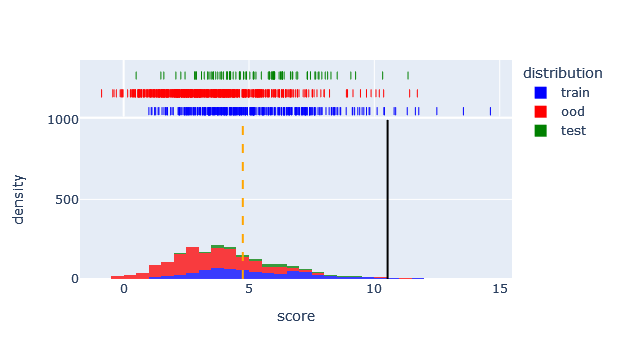

1/1 [==============================] - 0s 43ms/step
P=5.107574462890625 y_Q0=-3.0019609928131104  y_Qt=-0.827242374420166 y_Qinf=4.791334629058838


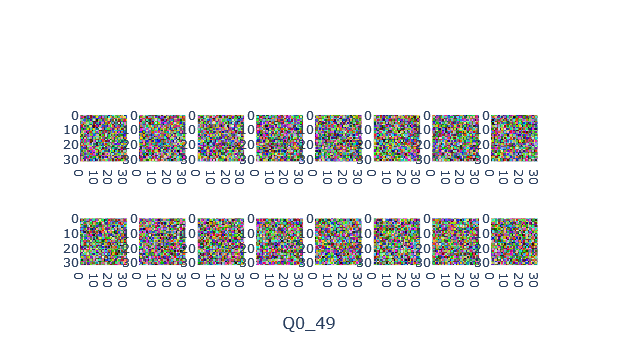

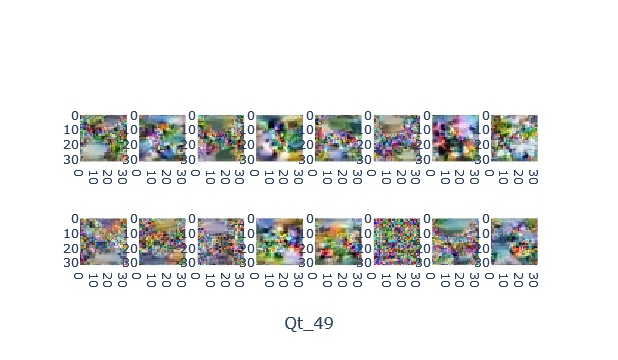

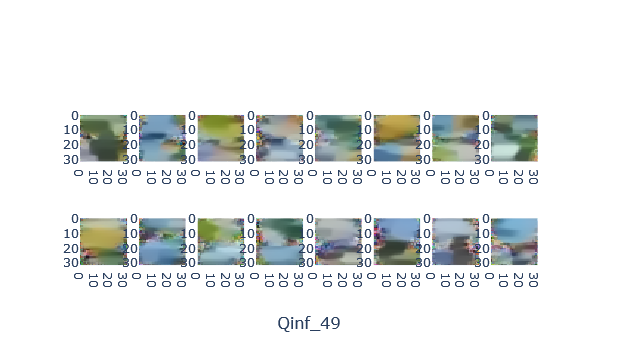

In [15]:
end_epoch = config.epochs_per_plot+epoch+1
for epoch in range(epoch+1, end_epoch):
  print(f"Epoch={epoch} LR={float(opt._decayed_lr(tf.float32)):.7f}")
  train(model, opt, loss_fn, gen, p_dataset, q_dataset, epoch_length, maxiter=config.maxiter, **train_kwargs)
  plot_histogram = (epoch+1 == end_epoch)
  plot_preds_ood(epoch, model, X_P, X_test, X_ood, plot_histogram=plot_histogram, plot_wandb=plot_wandb)
plot_gan(epoch, model, p_batch, Q0[:16], gen, maxiter=config.maxiter, **train_kwargs)

Epoch=50 LR=0.0001765


100%|██████████| 40/40 [01:28<00:00,  2.21s/it, FP=0.00%, GN_Qt=0.191, P=3.865, Q0=-3.459, Qt=-0.721, R=0.98%, lipschitz_ratio=3.984, loss=0.039]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.4282697, 14.027554), mean=4.0332575, variance=4.2260814, skewness=0.5302234888076782, kurtosis=0.5562725527613757)
Test examples DescribeResult(nobs=1000, minmax=(-0.7101835, 13.824021), mean=4.111502, variance=4.426215, skewness=0.5433084964752197, kurtosis=0.622968843098429)
OOD examples DescribeResult(nobs=9000, minmax=(-1.78553, 12.338944), mean=2.3324666, variance=3.278299, skewness=0.7574301958084106, kurtosis=0.9257188698674756)
[train/ood] Avg Dist=1.701 T=3.831 Acc=70.01%
[train/ood] AUROC =74.061
[test /ood] Avg Dist =1.7790355682373047 T=8.437 Acc=90.03%
[test /ood] AUROC =74.668
Epoch=51 LR=0.0001751


100%|██████████| 40/40 [01:28<00:00,  2.22s/it, FP=0.00%, GN_Qt=0.196, P=3.421, Q0=-3.684, Qt=-0.725, R=0.98%, lipschitz_ratio=3.876, loss=0.030]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 44ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.3838402, 15.836871), mean=4.4524903, variance=5.3528223, skewness=0.6482711434364319, kurtosis=0.6575083848464978)
Test examples DescribeResult(nobs=1000, minmax=(-0.7387182, 15.6074), mean=4.5581717, variance=5.7217793, skewness=0.6503267288208008, kurtosis=0.7080384952970973)
OOD examples DescribeResult(nobs=9000, minmax=(-1.874094, 13.038436), mean=2.5284305, variance=3.5789015, skewness=0.8104472160339355, kurtosis=1.0308075780785737)
[train/ood] Avg Dist=1.924 T=3.971 Acc=70.64%
[train/ood] AUROC =74.796
[test /ood] Avg Dist =2.0297412872314453 T=9.373 Acc=90.14%
[test /ood] AUROC =75.443
Epoch=52 LR=0.0001736


100%|██████████| 40/40 [01:28<00:00,  2.22s/it, FP=0.00%, GN_Qt=0.207, P=5.350, Q0=-3.498, Qt=-0.754, R=1.00%, lipschitz_ratio=3.894, loss=0.016]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.305984, 16.284637), mean=4.863623, variance=5.4301605, skewness=0.5951777100563049, kurtosis=0.6101466124315809)
Test examples DescribeResult(nobs=1000, minmax=(-0.48672992, 16.03069), mean=4.966421, variance=5.757137, skewness=0.6020770072937012, kurtosis=0.6744802283739988)
OOD examples DescribeResult(nobs=9000, minmax=(-1.849727, 13.391174), mean=2.9254007, variance=3.8333964, skewness=0.7561556696891785, kurtosis=0.9026084468800577)
[train/ood] Avg Dist=1.938 T=4.818 Acc=70.31%
[train/ood] AUROC =74.531
[test /ood] Avg Dist =2.041020393371582 T=10.349 Acc=90.13%
[test /ood] AUROC =75.206
Epoch=53 LR=0.0001721


100%|██████████| 40/40 [01:28<00:00,  2.22s/it, FP=0.00%, GN_Qt=0.173, P=3.949, Q0=-3.669, Qt=-0.737, R=0.98%, lipschitz_ratio=3.990, loss=0.023]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.7185987, 12.386607), mean=3.342816, variance=3.6239817, skewness=0.4926964342594147, kurtosis=0.6138661763906148)
Test examples DescribeResult(nobs=1000, minmax=(-1.0029689, 12.188664), mean=3.3964303, variance=3.6994925, skewness=0.494780570268631, kurtosis=0.5893977553022767)
OOD examples DescribeResult(nobs=9000, minmax=(-2.002818, 12.4747095), mean=1.8576255, variance=3.1614137, skewness=0.7808682322502136, kurtosis=1.113424581448549)
[train/ood] Avg Dist=1.485 T=3.200 Acc=69.05%
[train/ood] AUROC =72.514
[test /ood] Avg Dist =1.5388047695159912 T=11.815 Acc=90.00%
[test /ood] AUROC =73.034
Epoch=54 LR=0.0001707


100%|██████████| 40/40 [01:28<00:00,  2.22s/it, FP=0.00%, GN_Qt=0.207, P=4.030, Q0=-3.646, Qt=-0.820, R=1.00%, lipschitz_ratio=3.718, loss=0.030]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.661057, 14.402672), mean=3.7403915, variance=4.5746155, skewness=0.6086215972900391, kurtosis=0.6435392004688332)
Test examples DescribeResult(nobs=1000, minmax=(-1.0235747, 14.173544), mean=3.8309388, variance=4.8428955, skewness=0.6175896525382996, kurtosis=0.7261422295450313)
OOD examples DescribeResult(nobs=9000, minmax=(-1.9129108, 11.758758), mean=1.9716291, variance=3.3236825, skewness=0.8109138607978821, kurtosis=0.9920382146181614)
[train/ood] Avg Dist=1.769 T=3.358 Acc=70.24%
[train/ood] AUROC =74.352
[test /ood] Avg Dist =1.8593096733093262 T=8.422 Acc=90.08%
[test /ood] AUROC =74.996
Epoch=55 LR=0.0001692


100%|██████████| 40/40 [01:28<00:00,  2.22s/it, FP=0.00%, GN_Qt=0.177, P=3.679, Q0=-3.542, Qt=-0.789, R=0.98%, lipschitz_ratio=3.905, loss=0.029]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.292922, 16.17134), mean=4.4874287, variance=5.4350133, skewness=0.7110636234283447, kurtosis=0.7659210103705787)
Test examples DescribeResult(nobs=1000, minmax=(-0.5701167, 15.95243), mean=4.5902567, variance=5.827693, skewness=0.7178073525428772, kurtosis=0.833046892017629)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7442691, 13.302316), mean=2.606769, variance=3.6531022, skewness=0.8490636944770813, kurtosis=1.1102980806660483)
[train/ood] Avg Dist=1.881 T=4.029 Acc=70.10%
[train/ood] AUROC =74.206
[test /ood] Avg Dist =1.983487606048584 T=9.982 Acc=90.12%
[test /ood] AUROC =74.801
Epoch=56 LR=0.0001677


100%|██████████| 40/40 [01:28<00:00,  2.22s/it, FP=0.00%, GN_Qt=0.188, P=4.583, Q0=-3.633, Qt=-0.745, R=1.00%, lipschitz_ratio=3.842, loss=0.018]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.1761959, 16.901278), mean=4.9075484, variance=5.649124, skewness=0.7019948363304138, kurtosis=0.7883866917913527)
Test examples DescribeResult(nobs=1000, minmax=(-0.3109212, 16.671978), mean=5.015207, variance=6.0488605, skewness=0.7126425504684448, kurtosis=0.8693006957496872)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7680663, 13.933844), mean=2.96975, variance=3.765167, skewness=0.8243107795715332, kurtosis=1.1179445331909923)
[train/ood] Avg Dist=1.938 T=4.220 Acc=70.35%
[train/ood] AUROC =74.438
[test /ood] Avg Dist =2.045456886291504 T=10.676 Acc=90.12%
[test /ood] AUROC =75.085
Epoch=57 LR=0.0001663


100%|██████████| 40/40 [01:28<00:00,  2.22s/it, FP=0.00%, GN_Qt=0.176, P=3.101, Q0=-3.381, Qt=-0.718, R=0.99%, lipschitz_ratio=3.904, loss=0.023]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.607368, 12.905304), mean=3.383866, variance=3.661978, skewness=0.5466996431350708, kurtosis=0.5918846171612007)
Test examples DescribeResult(nobs=1000, minmax=(-0.86656815, 12.721318), mean=3.4626572, variance=3.8558457, skewness=0.5617834329605103, kurtosis=0.6859400724813915)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7146854, 10.868625), mean=1.7180259, variance=2.7620404, skewness=0.791292130947113, kurtosis=0.9535394093532221)
[train/ood] Avg Dist=1.666 T=3.173 Acc=71.00%
[train/ood] AUROC =75.243
[test /ood] Avg Dist =1.744631290435791 T=7.545 Acc=90.10%
[test /ood] AUROC =75.884
Epoch=58 LR=0.0001648


100%|██████████| 40/40 [01:28<00:00,  2.22s/it, FP=0.00%, GN_Qt=0.187, P=4.280, Q0=-3.772, Qt=-0.818, R=0.97%, lipschitz_ratio=3.730, loss=0.027]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.4781435, 13.737958), mean=3.960086, variance=3.9628322, skewness=0.5686540007591248, kurtosis=0.7378663002286143)
Test examples DescribeResult(nobs=1000, minmax=(-0.559547, 13.571553), mean=4.017106, variance=4.0891676, skewness=0.5893568992614746, kurtosis=0.7808527337825519)
OOD examples DescribeResult(nobs=9000, minmax=(-1.9125355, 12.925404), mean=2.4139812, variance=3.3056624, skewness=0.7612987160682678, kurtosis=1.0806775420657324)
[train/ood] Avg Dist=1.546 T=3.933 Acc=69.09%
[train/ood] AUROC =72.596
[test /ood] Avg Dist =1.6031248569488525 T=12.925 Acc=90.00%
[test /ood] AUROC =73.070
Epoch=59 LR=0.0001633


100%|██████████| 40/40 [01:28<00:00,  2.22s/it, FP=0.00%, GN_Qt=0.198, P=2.745, Q0=-4.213, Qt=-0.929, R=0.96%, lipschitz_ratio=3.507, loss=0.023]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.9304627, 14.313404), mean=3.541306, variance=4.5316887, skewness=0.642217218875885, kurtosis=0.7487538374694651)
Test examples DescribeResult(nobs=1000, minmax=(-1.1215962, 14.101554), mean=3.6364229, variance=4.827303, skewness=0.6539604067802429, kurtosis=0.8311825990969504)
OOD examples DescribeResult(nobs=9000, minmax=(-2.1297207, 11.544923), mean=1.7270775, variance=3.1859348, skewness=0.8077530264854431, kurtosis=1.0083015109128306)
[train/ood] Avg Dist=1.814 T=3.266 Acc=70.75%
[train/ood] AUROC =75.160
[test /ood] Avg Dist =1.9093453884124756 T=8.535 Acc=90.12%
[test /ood] AUROC =75.806
Epoch=60 LR=0.0001619


100%|██████████| 40/40 [01:28<00:00,  2.22s/it, FP=0.00%, GN_Qt=0.162, P=2.051, Q0=-3.989, Qt=-0.728, R=0.88%, lipschitz_ratio=3.932, loss=0.025]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.5761958, 15.854504), mean=3.801379, variance=5.7158585, skewness=0.7623003721237183, kurtosis=0.8204751233846594)
Test examples DescribeResult(nobs=1000, minmax=(-1.0752624, 15.6334505), mean=3.9083095, variance=6.1553383, skewness=0.7656259536743164, kurtosis=0.8984530423517265)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7491142, 12.897241), mean=1.8808392, variance=3.7623916, skewness=0.9248299598693848, kurtosis=1.1678864887085778)
[train/ood] Avg Dist=1.921 T=3.342 Acc=70.08%
[train/ood] AUROC =74.266
[test /ood] Avg Dist =2.027470111846924 T=9.522 Acc=90.12%
[test /ood] AUROC =74.863
Epoch=61 LR=0.0001604


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.173, P=4.584, Q0=-3.609, Qt=-0.713, R=0.98%, lipschitz_ratio=3.873, loss=0.024]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.309211, 15.246877), mean=4.549753, variance=4.582039, skewness=0.6198573708534241, kurtosis=0.7507042404952244)
Test examples DescribeResult(nobs=1000, minmax=(-0.25704157, 15.040246), mean=4.625911, variance=4.807012, skewness=0.642533004283905, kurtosis=0.8377031053410668)
OOD examples DescribeResult(nobs=9000, minmax=(-1.783553, 13.319894), mean=2.8494043, variance=3.5680392, skewness=0.7662476897239685, kurtosis=1.009937008205739)
[train/ood] Avg Dist=1.700 T=4.338 Acc=69.35%
[train/ood] AUROC =73.292
[test /ood] Avg Dist =1.7765069007873535 T=9.551 Acc=90.04%
[test /ood] AUROC =73.847
Epoch=62 LR=0.0001589


100%|██████████| 40/40 [01:28<00:00,  2.22s/it, FP=0.00%, GN_Qt=0.200, P=3.992, Q0=-3.553, Qt=-0.721, R=0.96%, lipschitz_ratio=3.815, loss=0.022]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.6146852, 14.175977), mean=3.6124885, variance=4.3039646, skewness=0.673884391784668, kurtosis=0.8201442751105472)
Test examples DescribeResult(nobs=1000, minmax=(-0.80459684, 13.975725), mean=3.6840854, variance=4.5356584, skewness=0.6929945349693298, kurtosis=0.9108901001167062)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7749962, 12.167677), mean=1.9805925, variance=3.279051, skewness=0.8374281525611877, kurtosis=1.1108623232862165)
[train/ood] Avg Dist=1.632 T=3.561 Acc=69.24%
[train/ood] AUROC =73.242
[test /ood] Avg Dist =1.7034928798675537 T=8.537 Acc=90.04%
[test /ood] AUROC =73.742
Epoch=63 LR=0.0001574


100%|██████████| 40/40 [01:28<00:00,  2.22s/it, FP=0.00%, GN_Qt=0.152, P=4.184, Q0=-3.478, Qt=-0.765, R=1.00%, lipschitz_ratio=3.975, loss=0.028]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.4001967, 16.17724), mean=4.469993, variance=5.0201035, skewness=0.7908854484558105, kurtosis=1.0449328238150999)
Test examples DescribeResult(nobs=1000, minmax=(-0.27431235, 15.992388), mean=4.570364, variance=5.4098234, skewness=0.8089867234230042, kurtosis=1.1388487257598339)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7941027, 13.267815), mean=2.6564245, variance=3.2968407, skewness=0.8597157001495361, kurtosis=1.2912719049734873)
[train/ood] Avg Dist=1.814 T=3.888 Acc=70.38%
[train/ood] AUROC =74.514
[test /ood] Avg Dist =1.9139394760131836 T=10.030 Acc=90.12%
[test /ood] AUROC =75.105
Epoch=64 LR=0.0001560


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.158, P=3.736, Q0=-3.733, Qt=-0.770, R=0.96%, lipschitz_ratio=3.901, loss=0.032]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.4749416, 16.37096), mean=4.3171, variance=5.340298, skewness=0.8097493052482605, kurtosis=1.041018405382709)
Test examples DescribeResult(nobs=1000, minmax=(-0.5660409, 16.186295), mean=4.408493, variance=5.736018, skewness=0.8323236703872681, kurtosis=1.1421070617059863)
OOD examples DescribeResult(nobs=9000, minmax=(-1.9090465, 13.391395), mean=2.5894797, variance=3.617581, skewness=0.8533626794815063, kurtosis=1.2255529222168215)
[train/ood] Avg Dist=1.728 T=3.932 Acc=69.11%
[train/ood] AUROC =72.703
[test /ood] Avg Dist =1.8190133571624756 T=9.712 Acc=90.08%
[test /ood] AUROC =73.214
Epoch=65 LR=0.0001545


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.185, P=3.795, Q0=-3.812, Qt=-0.741, R=0.98%, lipschitz_ratio=3.752, loss=0.030]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.5536821, 15.308078), mean=4.073146, variance=4.6791344, skewness=0.7451093196868896, kurtosis=0.9724655932052757)
Test examples DescribeResult(nobs=1000, minmax=(-0.5817128, 15.116576), mean=4.1526427, variance=4.984156, skewness=0.773992657661438, kurtosis=1.087603500325998)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7910967, 12.462219), mean=2.4039762, variance=3.4195437, skewness=0.8333723545074463, kurtosis=1.1540471412121809)
[train/ood] Avg Dist=1.669 T=3.664 Acc=69.13%
[train/ood] AUROC =73.075
[test /ood] Avg Dist =1.748666524887085 T=9.022 Acc=90.06%
[test /ood] AUROC =73.569
Epoch=66 LR=0.0001530


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.182, P=3.764, Q0=-3.786, Qt=-0.755, R=0.98%, lipschitz_ratio=3.814, loss=0.020]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.4111288, 14.809792), mean=4.1471972, variance=4.414305, skewness=0.6962643265724182, kurtosis=0.9053081166757169)
Test examples DescribeResult(nobs=1000, minmax=(-0.4800335, 14.65178), mean=4.2111416, variance=4.6386437, skewness=0.7294030785560608, kurtosis=1.0096829140796029)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7567948, 13.270987), mean=2.5782053, variance=3.5506282, skewness=0.8128111958503723, kurtosis=1.1239134295444924)
[train/ood] Avg Dist=1.569 T=4.062 Acc=68.33%
[train/ood] AUROC =72.063
[test /ood] Avg Dist =1.6329362392425537 T=13.271 Acc=90.00%
[test /ood] AUROC =72.492
Epoch=67 LR=0.0001516


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.179, P=4.050, Q0=-3.848, Qt=-0.770, R=0.98%, lipschitz_ratio=3.812, loss=0.030]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.981835, 13.014294), mean=2.9642525, variance=3.7702837, skewness=0.6877355575561523, kurtosis=0.9447755547438277)
Test examples DescribeResult(nobs=1000, minmax=(-1.2017945, 12.852224), mean=3.0248837, variance=3.9583504, skewness=0.7184650301933289, kurtosis=1.0433096131434008)
OOD examples DescribeResult(nobs=9000, minmax=(-2.0732076, 11.63235), mean=1.4911658, variance=3.0091047, skewness=0.8469935655593872, kurtosis=1.2069908909148293)
[train/ood] Avg Dist=1.473 T=3.025 Acc=68.72%
[train/ood] AUROC =72.441
[test /ood] Avg Dist =1.5337179899215698 T=11.632 Acc=90.00%
[test /ood] AUROC =72.887
Epoch=68 LR=0.0001501


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.162, P=3.811, Q0=-3.883, Qt=-0.788, R=0.98%, lipschitz_ratio=3.761, loss=0.042]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.8194197, 14.890985), mean=3.552529, variance=4.757278, skewness=0.7810108065605164, kurtosis=0.9976504692589421)
Test examples DescribeResult(nobs=1000, minmax=(-1.0062876, 14.720005), mean=3.629607, variance=5.0710845, skewness=0.8076795935630798, kurtosis=1.1134185652514317)
OOD examples DescribeResult(nobs=9000, minmax=(-1.9533185, 12.201506), mean=1.9373242, variance=3.4934514, skewness=0.8715035319328308, kurtosis=1.1828444892866017)
[train/ood] Avg Dist=1.615 T=3.638 Acc=68.46%
[train/ood] AUROC =72.269
[test /ood] Avg Dist =1.692282795906067 T=8.470 Acc=90.04%
[test /ood] AUROC =72.734
Epoch=69 LR=0.0001486


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.182, P=3.371, Q0=-3.949, Qt=-0.794, R=0.99%, lipschitz_ratio=3.655, loss=0.031]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.7282485, 15.384814), mean=3.960786, variance=4.741797, skewness=0.7767921090126038, kurtosis=1.0526800484769625)
Test examples DescribeResult(nobs=1000, minmax=(-0.7321782, 15.21), mean=4.037985, variance=5.0466433, skewness=0.810472846031189, kurtosis=1.1814484445188143)
OOD examples DescribeResult(nobs=9000, minmax=(-1.9593719, 12.561564), mean=2.3316689, variance=3.4740908, skewness=0.8410170078277588, kurtosis=1.208067416922053)
[train/ood] Avg Dist=1.629 T=3.841 Acc=68.67%
[train/ood] AUROC =72.478
[test /ood] Avg Dist =1.7063159942626953 T=8.885 Acc=90.05%
[test /ood] AUROC =72.953
Epoch=70 LR=0.0001472


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.169, P=4.714, Q0=-3.797, Qt=-0.754, R=0.98%, lipschitz_ratio=3.854, loss=0.023]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.1336467, 17.563877), mean=4.994082, variance=5.957424, skewness=0.8174808621406555, kurtosis=1.0164482152392509)
Test examples DescribeResult(nobs=1000, minmax=(-0.1553343, 17.40258), mean=5.0826287, variance=6.3745646, skewness=0.8468488454818726, kurtosis=1.1330055753394364)
OOD examples DescribeResult(nobs=9000, minmax=(-1.8177621, 14.460877), mean=3.2367256, variance=4.2053866, skewness=0.850376546382904, kurtosis=1.158187473997816)
[train/ood] Avg Dist=1.757 T=5.022 Acc=68.16%
[train/ood] AUROC =71.809
[test /ood] Avg Dist =1.8459031581878662 T=10.754 Acc=90.06%
[test /ood] AUROC =72.289
Epoch=71 LR=0.0001457


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.211, P=3.448, Q0=-4.481, Qt=-0.718, R=0.98%, lipschitz_ratio=3.396, loss=0.030]


36/36 [==============================] - 2s 44ms/step
Train examples DescribeResult(nobs=5120, minmax=(-2.09035, 14.336104), mean=3.432122, variance=4.348964, skewness=0.6988885402679443, kurtosis=0.9456827971403983)
Test examples DescribeResult(nobs=1000, minmax=(-1.0700815, 14.13885), mean=3.514026, variance=4.602943, skewness=0.719853401184082, kurtosis=1.0600459334945027)
OOD examples DescribeResult(nobs=9000, minmax=(-2.1708474, 11.66447), mean=1.7657808, variance=3.2550304, skewness=0.8189082145690918, kurtosis=1.1069059029168962)
[train/ood] Avg Dist=1.666 T=3.162 Acc=69.60%
[train/ood] AUROC =73.681
[test /ood] Avg Dist =1.748245120048523 T=8.111 Acc=90.05%
[test /ood] AUROC =74.275
Epoch=72 LR=0.0001442


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.142, P=4.831, Q0=-3.521, Qt=-0.744, R=1.00%, lipschitz_ratio=3.963, loss=0.031]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.7976594, 15.76078), mean=4.0331483, variance=4.930923, skewness=0.7890956401824951, kurtosis=1.094003260862129)
Test examples DescribeResult(nobs=1000, minmax=(-0.80257076, 15.5913315), mean=4.1162233, variance=5.250871, skewness=0.8199665546417236, kurtosis=1.2195378697097574)
OOD examples DescribeResult(nobs=9000, minmax=(-2.0020792, 12.797785), mean=2.3727689, variance=3.573702, skewness=0.8342069983482361, kurtosis=1.2015217830654237)
[train/ood] Avg Dist=1.660 T=3.882 Acc=68.70%
[train/ood] AUROC =72.511
[test /ood] Avg Dist =1.7434544563293457 T=9.083 Acc=90.07%
[test /ood] AUROC =73.038
Epoch=73 LR=0.0001428


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.167, P=5.228, Q0=-3.596, Qt=-0.784, R=0.98%, lipschitz_ratio=3.892, loss=0.026]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.5050513, 17.005701), mean=4.624119, variance=5.634557, skewness=0.7994696497917175, kurtosis=1.0444360376026767)
Test examples DescribeResult(nobs=1000, minmax=(-0.37322512, 16.826029), mean=4.713122, variance=6.0062056, skewness=0.8266149759292603, kurtosis=1.1693235811332894)
OOD examples DescribeResult(nobs=9000, minmax=(-1.8892946, 13.9314785), mean=2.871719, variance=4.03953, skewness=0.8483403921127319, kurtosis=1.1884400067093521)
[train/ood] Avg Dist=1.752 T=4.663 Acc=68.47%
[train/ood] AUROC =72.276
[test /ood] Avg Dist =1.8414030075073242 T=10.065 Acc=90.06%
[test /ood] AUROC =72.808
Epoch=74 LR=0.0001413


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.195, P=4.556, Q0=-4.067, Qt=-0.689, R=0.99%, lipschitz_ratio=3.669, loss=0.025]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-2.1324825, 15.058346), mean=2.850647, variance=5.234511, skewness=0.8620225787162781, kurtosis=1.1224370271147484)
Test examples DescribeResult(nobs=1000, minmax=(-1.5922438, 14.88045), mean=2.952106, variance=5.63777, skewness=0.8731662631034851, kurtosis=1.2274489480843958)
OOD examples DescribeResult(nobs=9000, minmax=(-2.1988692, 12.042866), mean=1.0751966, variance=3.3955915, skewness=1.0033382177352905, kurtosis=1.439136433008814)
[train/ood] Avg Dist=1.775 T=2.405 Acc=69.79%
[train/ood] AUROC =73.807
[test /ood] Avg Dist =1.8769093751907349 T=8.053 Acc=90.10%
[test /ood] AUROC =74.417
Epoch=75 LR=0.0001398


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.138, P=3.527, Q0=-3.598, Qt=-0.801, R=0.98%, lipschitz_ratio=3.775, loss=0.034]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.7005677, 16.087217), mean=3.825463, variance=5.315946, skewness=0.8412426710128784, kurtosis=1.1122573408572505)
Test examples DescribeResult(nobs=1000, minmax=(-0.84613246, 15.89853), mean=3.9253702, variance=5.732637, skewness=0.8600191473960876, kurtosis=1.2349323141400408)
OOD examples DescribeResult(nobs=9000, minmax=(-1.6700699, 13.018971), mean=2.0147905, variance=3.5833614, skewness=0.9496707916259766, kurtosis=1.371732859992436)
[train/ood] Avg Dist=1.811 T=3.327 Acc=69.72%
[train/ood] AUROC =73.903
[test /ood] Avg Dist =1.9105796813964844 T=9.152 Acc=90.10%
[test /ood] AUROC =74.481
Epoch=76 LR=0.0001383


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.185, P=3.104, Q0=-4.476, Qt=-0.800, R=0.95%, lipschitz_ratio=3.510, loss=0.025]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.7195395, 17.37816), mean=4.40713, variance=6.210095, skewness=0.8425151109695435, kurtosis=1.0755280728127712)
Test examples DescribeResult(nobs=1000, minmax=(-0.7698374, 17.20089), mean=4.5030184, variance=6.6645594, skewness=0.8669313788414001, kurtosis=1.1877644123817657)
OOD examples DescribeResult(nobs=9000, minmax=(-1.9869162, 14.183592), mean=2.606416, variance=4.31843, skewness=0.8809581398963928, kurtosis=1.2185232266981014)
[train/ood] Avg Dist=1.801 T=4.506 Acc=68.17%
[train/ood] AUROC =71.991
[test /ood] Avg Dist =1.8966023921966553 T=10.103 Acc=90.06%
[test /ood] AUROC =72.504
Epoch=77 LR=0.0001369


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.165, P=2.389, Q0=-4.598, Qt=-0.824, R=0.89%, lipschitz_ratio=3.466, loss=0.026]


36/36 [==============================] - 2s 44ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.9458395, 15.927113), mean=3.630015, variance=5.322339, skewness=0.8728097677230835, kurtosis=1.1827038675764845)
Test examples DescribeResult(nobs=1000, minmax=(-1.0210477, 15.73015), mean=3.7265654, variance=5.7420325, skewness=0.8926166296005249, kurtosis=1.3002453618676357)
OOD examples DescribeResult(nobs=9000, minmax=(-2.0101, 12.878925), mean=1.8709774, variance=3.5862083, skewness=0.9415037035942078, kurtosis=1.3862865703331737)
[train/ood] Avg Dist=1.759 T=3.156 Acc=69.30%
[train/ood] AUROC =73.318
[test /ood] Avg Dist =1.8555879592895508 T=9.059 Acc=90.09%
[test /ood] AUROC =73.867
Epoch=78 LR=0.0001354


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.192, P=4.906, Q0=-4.055, Qt=-0.782, R=0.99%, lipschitz_ratio=3.553, loss=0.022]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.5254933, 17.182524), mean=4.6792955, variance=5.6852365, skewness=0.8429837226867676, kurtosis=1.1264210945173039)
Test examples DescribeResult(nobs=1000, minmax=(-0.3496877, 17.001875), mean=4.7653146, variance=6.0888915, skewness=0.8725653886795044, kurtosis=1.2463324299933918)
OOD examples DescribeResult(nobs=9000, minmax=(-1.9077197, 14.117914), mean=2.9716663, variance=4.0172386, skewness=0.8637454509735107, kurtosis=1.2528484628863978)
[train/ood] Avg Dist=1.708 T=4.533 Acc=68.07%
[train/ood] AUROC =71.772
[test /ood] Avg Dist =1.7936482429504395 T=10.209 Acc=90.05%
[test /ood] AUROC =72.240
Epoch=79 LR=0.0001339


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.147, P=4.351, Q0=-3.964, Qt=-0.821, R=0.97%, lipschitz_ratio=3.694, loss=0.024]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 44ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.5073924, 17.891544), mean=4.6492386, variance=6.395097, skewness=0.891530454158783, kurtosis=1.1534121912089494)
Test examples DescribeResult(nobs=1000, minmax=(-0.4562962, 17.727629), mean=4.75079, variance=6.9037356, skewness=0.9123395085334778, kurtosis=1.261544577869043)
OOD examples DescribeResult(nobs=9000, minmax=(-1.8344945, 14.688402), mean=2.8197482, variance=4.2444897, skewness=0.916867733001709, kurtosis=1.3295112188692162)
[train/ood] Avg Dist=1.829 T=4.186 Acc=68.41%
[train/ood] AUROC =72.214
[test /ood] Avg Dist =1.931041955947876 T=10.977 Acc=90.08%
[test /ood] AUROC =72.740
Epoch=80 LR=0.0001325


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.141, P=3.661, Q0=-4.202, Qt=-0.843, R=0.97%, lipschitz_ratio=3.659, loss=0.035]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.8390037, 16.845743), mean=3.6615424, variance=6.18396, skewness=0.944399893283844, kurtosis=1.2277162500207313)
Test examples DescribeResult(nobs=1000, minmax=(-1.0890014, 16.693306), mean=3.758139, variance=6.708446, skewness=0.9654752016067505, kurtosis=1.3400769924447617)
OOD examples DescribeResult(nobs=9000, minmax=(-1.9087855, 13.645004), mean=1.8934917, variance=4.00561, skewness=0.9962741136550903, kurtosis=1.4798086602321918)
[train/ood] Avg Dist=1.768 T=3.708 Acc=68.25%
[train/ood] AUROC =72.053
[test /ood] Avg Dist =1.8646471500396729 T=9.498 Acc=90.07%
[test /ood] AUROC =72.502
Epoch=81 LR=0.0001310


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.171, P=4.452, Q0=-4.201, Qt=-0.793, R=0.99%, lipschitz_ratio=3.590, loss=0.015]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.9684896, 17.756344), mean=3.8450313, variance=6.9084606, skewness=0.9631943702697754, kurtosis=1.2460636953755309)
Test examples DescribeResult(nobs=1000, minmax=(-1.1499808, 17.56943), mean=3.9701688, variance=7.549113, skewness=0.9615973234176636, kurtosis=1.3014678497866718)
OOD examples DescribeResult(nobs=9000, minmax=(-2.0627723, 14.468316), mean=1.8703672, variance=4.121505, skewness=1.0811347961425781, kurtosis=1.7967166744620044)
[train/ood] Avg Dist=1.975 T=3.310 Acc=69.62%
[train/ood] AUROC =73.590
[test /ood] Avg Dist =2.099801540374756 T=10.328 Acc=90.12%
[test /ood] AUROC =74.175
Epoch=82 LR=0.0001295


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.161, P=4.266, Q0=-3.983, Qt=-0.681, R=0.98%, lipschitz_ratio=3.653, loss=0.017]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.4361069, 17.600376), mean=4.572004, variance=6.175466, skewness=0.9112145304679871, kurtosis=1.1811760677050147)
Test examples DescribeResult(nobs=1000, minmax=(-0.37118056, 17.436121), mean=4.6610336, variance=6.663673, skewness=0.9364992380142212, kurtosis=1.2971267082570126)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7929182, 14.431474), mean=2.858558, variance=4.18937, skewness=0.9182214140892029, kurtosis=1.3235543751310264)
[train/ood] Avg Dist=1.713 T=5.223 Acc=67.73%
[train/ood] AUROC =71.186
[test /ood] Avg Dist =1.8024756908416748 T=11.198 Acc=90.08%
[test /ood] AUROC =71.604
Epoch=83 LR=0.0001281


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.176, P=3.285, Q0=-4.778, Qt=-0.813, R=0.95%, lipschitz_ratio=3.404, loss=0.022]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.8597581, 17.23214), mean=4.1290007, variance=6.215629, skewness=0.8908233046531677, kurtosis=1.147067469648638)
Test examples DescribeResult(nobs=1000, minmax=(-0.86510503, 17.05711), mean=4.2314496, variance=6.7248993, skewness=0.9063959121704102, kurtosis=1.2476652307527898)
OOD examples DescribeResult(nobs=9000, minmax=(-2.0410283, 14.023333), mean=2.3051512, variance=4.1035566, skewness=0.9347105622291565, kurtosis=1.369363679625292)
[train/ood] Avg Dist=1.824 T=3.605 Acc=68.60%
[train/ood] AUROC =72.484
[test /ood] Avg Dist =1.9262983798980713 T=10.099 Acc=90.08%
[test /ood] AUROC =73.007
Epoch=84 LR=0.0001266


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.143, P=3.699, Q0=-4.522, Qt=-0.934, R=0.99%, lipschitz_ratio=3.475, loss=0.025]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.6965567, 17.920073), mean=4.2475915, variance=6.8447833, skewness=0.952297031879425, kurtosis=1.2004041842839186)
Test examples DescribeResult(nobs=1000, minmax=(-0.7906908, 17.754152), mean=4.357514, variance=7.46519, skewness=0.9597655534744263, kurtosis=1.269267041635569)
OOD examples DescribeResult(nobs=9000, minmax=(-1.944755, 14.667718), mean=2.3695276, variance=4.245384, skewness=1.0044184923171997, kurtosis=1.5544345206423724)
[train/ood] Avg Dist=1.878 T=4.699 Acc=68.63%
[train/ood] AUROC =72.377
[test /ood] Avg Dist =1.9879863262176514 T=9.785 Acc=90.11%
[test /ood] AUROC =72.851
Epoch=85 LR=0.0001251


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.183, P=3.946, Q0=-4.504, Qt=-0.911, R=1.00%, lipschitz_ratio=3.341, loss=0.020]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.8778266, 16.977703), mean=4.087556, variance=5.9143357, skewness=0.8786447048187256, kurtosis=1.1741112455679863)
Test examples DescribeResult(nobs=1000, minmax=(-0.8639013, 16.797335), mean=4.182222, variance=6.3787675, skewness=0.8994887471199036, kurtosis=1.2844000719000483)
OOD examples DescribeResult(nobs=9000, minmax=(-2.0120056, 13.727669), mean=2.342656, variance=4.020942, skewness=0.9141975045204163, kurtosis=1.3462875531615444)
[train/ood] Avg Dist=1.745 T=3.962 Acc=68.28%
[train/ood] AUROC =71.997
[test /ood] Avg Dist =1.8395659923553467 T=9.629 Acc=90.07%
[test /ood] AUROC =72.494
Epoch=86 LR=0.0001237


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.156, P=2.735, Q0=-4.682, Qt=-0.829, R=0.91%, lipschitz_ratio=3.495, loss=0.033]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.8932521, 17.625362), mean=3.6765702, variance=7.0751443, skewness=0.944423496723175, kurtosis=1.1583193934027811)
Test examples DescribeResult(nobs=1000, minmax=(-1.3095124, 17.475782), mean=3.7872543, variance=7.684847, skewness=0.9539020657539368, kurtosis=1.24520030379826)
OOD examples DescribeResult(nobs=9000, minmax=(-1.9770008, 14.238522), mean=1.819175, variance=4.4110365, skewness=1.030749797821045, kurtosis=1.534513687728909)
[train/ood] Avg Dist=1.857 T=4.093 Acc=68.31%
[train/ood] AUROC =71.782
[test /ood] Avg Dist =1.9680793285369873 T=9.805 Acc=90.08%
[test /ood] AUROC =72.306
Epoch=87 LR=0.0001222


100%|██████████| 40/40 [01:29<00:00,  2.25s/it, FP=0.00%, GN_Qt=0.145, P=4.136, Q0=-4.282, Qt=-0.878, R=0.97%, lipschitz_ratio=3.606, loss=0.037]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.3411351, 19.66197), mean=4.995243, variance=8.192978, skewness=0.9162648916244507, kurtosis=1.0587488394892457)
Test examples DescribeResult(nobs=1000, minmax=(-0.5979563, 19.517248), mean=5.1109276, variance=8.882509, skewness=0.9292489886283875, kurtosis=1.14567232272441)
OOD examples DescribeResult(nobs=9000, minmax=(-1.754516, 16.14569), mean=3.0479052, variance=5.1917696, skewness=0.9600349068641663, kurtosis=1.3640266753735322)
[train/ood] Avg Dist=1.947 T=5.717 Acc=68.09%
[train/ood] AUROC =71.062
[test /ood] Avg Dist =2.0630223751068115 T=11.701 Acc=90.08%
[test /ood] AUROC =71.582
Epoch=88 LR=0.0001207


100%|██████████| 40/40 [01:30<00:00,  2.25s/it, FP=0.00%, GN_Qt=0.144, P=4.026, Q0=-4.382, Qt=-0.825, R=0.98%, lipschitz_ratio=3.582, loss=0.027]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.7746019, 18.278324), mean=4.152143, variance=7.262971, skewness=0.9287144541740417, kurtosis=1.1532769374620964)
Test examples DescribeResult(nobs=1000, minmax=(-1.0573074, 18.126146), mean=4.269798, variance=7.8906612, skewness=0.937653124332428, kurtosis=1.2395997492697575)
OOD examples DescribeResult(nobs=9000, minmax=(-1.8694888, 14.848787), mean=2.2233438, variance=4.5251503, skewness=1.0038074254989624, kurtosis=1.5216759186888131)
[train/ood] Avg Dist=1.929 T=4.505 Acc=68.64%
[train/ood] AUROC =72.259
[test /ood] Avg Dist =2.0464539527893066 T=10.358 Acc=90.08%
[test /ood] AUROC =72.835
Epoch=89 LR=0.0001192


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.161, P=4.971, Q0=-4.400, Qt=-0.908, R=0.98%, lipschitz_ratio=3.526, loss=0.016]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.5983549, 18.934788), mean=4.8255224, variance=7.402007, skewness=0.9057416319847107, kurtosis=1.1002390646729001)
Test examples DescribeResult(nobs=1000, minmax=(-0.57846546, 18.764877), mean=4.9390063, variance=8.020576, skewness=0.9163445234298706, kurtosis=1.1799102546895774)
OOD examples DescribeResult(nobs=9000, minmax=(-1.9646875, 15.510533), mean=2.9271643, variance=4.6951923, skewness=0.9431362748146057, kurtosis=1.4036781486490852)
[train/ood] Avg Dist=1.898 T=5.433 Acc=68.34%
[train/ood] AUROC =71.591
[test /ood] Avg Dist =2.0118420124053955 T=11.204 Acc=90.09%
[test /ood] AUROC =72.134


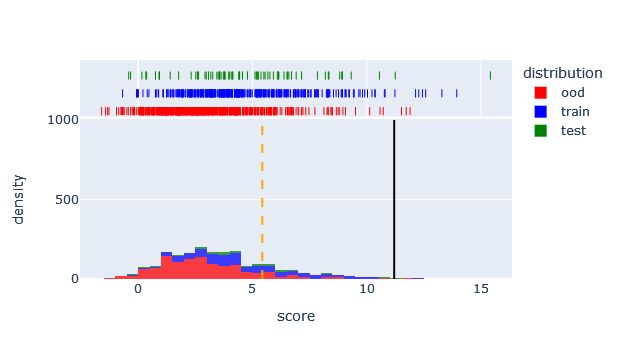

1/1 [==============================] - 0s 40ms/step
P=4.624877452850342 y_Q0=-4.551224708557129  y_Qt=-0.8975049257278442 y_Qinf=4.037149906158447


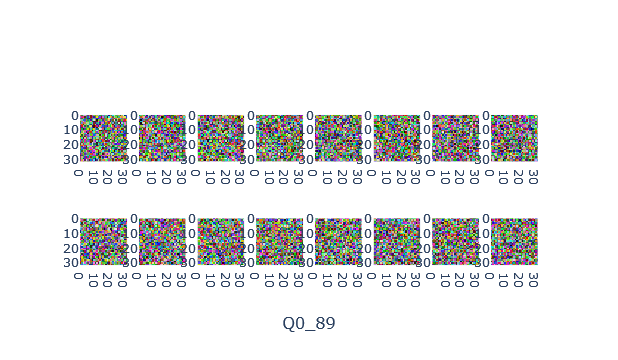

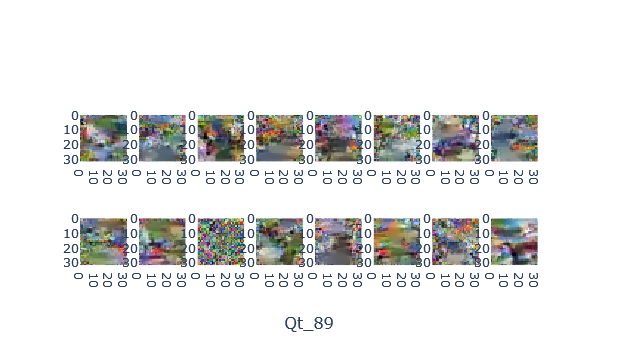

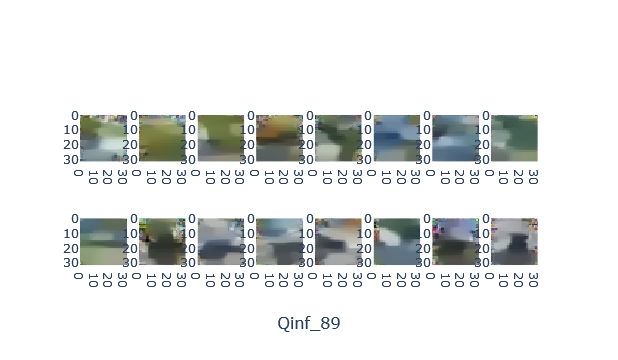

In [16]:
end_epoch = config.epochs_per_plot+epoch+1
for epoch in range(epoch+1, end_epoch):
  print(f"Epoch={epoch} LR={float(opt._decayed_lr(tf.float32)):.7f}")
  train(model, opt, loss_fn, gen, p_dataset, q_dataset, epoch_length, maxiter=config.maxiter, **train_kwargs)
  plot_histogram = (epoch+1 == end_epoch)
  plot_preds_ood(epoch, model, X_P, X_test, X_ood, plot_histogram=plot_histogram, plot_wandb=plot_wandb)
plot_gan(epoch, model, p_batch, Q0[:16], gen, maxiter=config.maxiter, **train_kwargs)

In [ ]:
end_epoch = config.epochs_per_plot+epoch+1
for epoch in range(epoch+1, end_epoch):
  print(f"Epoch={epoch} LR={float(opt._decayed_lr(tf.float32)):.7f}")
  train(model, opt, loss_fn, gen, p_dataset, q_dataset, epoch_length, maxiter=config.maxiter, **train_kwargs)
  plot_histogram = (epoch+1 == end_epoch)
  plot_preds_ood(epoch, model, X_P, X_test, X_ood, plot_histogram=plot_histogram, plot_wandb=plot_wandb)
plot_gan(epoch, model, p_batch, Q0[:16], gen, maxiter=config.maxiter, **train_kwargs)

Epoch=90 LR=0.0001178


100%|██████████| 40/40 [01:28<00:00,  2.22s/it, FP=0.00%, GN_Qt=0.143, P=4.890, Q0=-4.186, Qt=-0.779, R=0.99%, lipschitz_ratio=3.666, loss=0.024]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.7661757, 18.821922), mean=4.4630065, variance=7.579564, skewness=0.9311050176620483, kurtosis=1.13676440109918)
Test examples DescribeResult(nobs=1000, minmax=(-0.88835996, 18.65816), mean=4.5895357, variance=8.252268, skewness=0.9315508008003235, kurtosis=1.2018306687722697)
OOD examples DescribeResult(nobs=9000, minmax=(-1.9088125, 15.381357), mean=2.4650335, variance=4.6075435, skewness=1.019250512123108, kurtosis=1.5993676095629343)
[train/ood] Avg Dist=1.998 T=4.653 Acc=68.96%
[train/ood] AUROC =72.646
[test /ood] Avg Dist =2.124502182006836 T=11.918 Acc=90.11%
[test /ood] AUROC =73.252
Epoch=91 LR=0.0001163


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.182, P=4.736, Q0=-4.570, Qt=-0.819, R=0.98%, lipschitz_ratio=3.437, loss=0.024]


36/36 [==============================] - 2s 44ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.8208411, 18.531006), mean=4.4125457, variance=7.3235593, skewness=0.9198117852210999, kurtosis=1.1359351959909247)
Test examples DescribeResult(nobs=1000, minmax=(-0.9118502, 18.372839), mean=4.540876, variance=7.9704967, skewness=0.9185448288917542, kurtosis=1.197841562313152)
OOD examples DescribeResult(nobs=9000, minmax=(-1.97699, 15.151823), mean=2.4000945, variance=4.447424, skewness=1.0134660005569458, kurtosis=1.6086254932514708)
[train/ood] Avg Dist=2.012 T=4.033 Acc=69.25%
[train/ood] AUROC =73.169
[test /ood] Avg Dist =2.1407814025878906 T=11.601 Acc=90.12%
[test /ood] AUROC =73.810
Epoch=92 LR=0.0001148


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.182, P=3.333, Q0=-5.193, Qt=-0.755, R=0.91%, lipschitz_ratio=3.306, loss=0.027]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-2.045781, 18.28808), mean=3.8570557, variance=7.64693, skewness=0.9307379126548767, kurtosis=1.1169569404226758)
Test examples DescribeResult(nobs=1000, minmax=(-1.4162017, 18.111523), mean=3.9857516, variance=8.3315525, skewness=0.9290782809257507, kurtosis=1.1782415636880232)
OOD examples DescribeResult(nobs=9000, minmax=(-2.1493928, 14.831932), mean=1.8313832, variance=4.6200886, skewness=1.0466423034667969, kurtosis=1.614775015414395)
[train/ood] Avg Dist=2.026 T=4.068 Acc=69.09%
[train/ood] AUROC =72.869
[test /ood] Avg Dist =2.1543684005737305 T=11.186 Acc=90.12%
[test /ood] AUROC =73.488
Epoch=93 LR=0.0001134


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.167, P=3.730, Q0=-4.996, Qt=-0.828, R=0.97%, lipschitz_ratio=3.367, loss=0.021]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.7077394, 19.055014), mean=4.4666405, variance=7.900672, skewness=0.9204586148262024, kurtosis=1.0903149043067986)
Test examples DescribeResult(nobs=1000, minmax=(-1.0208862, 18.896952), mean=4.5818996, variance=8.576033, skewness=0.9317594170570374, kurtosis=1.1799002965342842)
OOD examples DescribeResult(nobs=9000, minmax=(-1.9491111, 15.484518), mean=2.5427022, variance=4.983453, skewness=0.9795008897781372, kurtosis=1.4362083616044758)
[train/ood] Avg Dist=1.924 T=4.720 Acc=68.17%
[train/ood] AUROC =71.235
[test /ood] Avg Dist =2.0391974449157715 T=11.054 Acc=90.08%
[test /ood] AUROC =71.756
Epoch=94 LR=0.0001119


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.170, P=3.348, Q0=-4.893, Qt=-0.906, R=0.94%, lipschitz_ratio=3.300, loss=0.025]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.5869418, 18.332142), mean=4.430223, variance=7.110117, skewness=0.8978734016418457, kurtosis=1.082556914104785)
Test examples DescribeResult(nobs=1000, minmax=(-0.7951324, 18.184582), mean=4.531261, variance=7.6845155, skewness=0.9168469309806824, kurtosis=1.1941314227866107)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7388513, 14.844818), mean=2.607732, variance=4.718861, skewness=0.9479756951332092, kurtosis=1.352735991524395)
[train/ood] Avg Dist=1.822 T=5.005 Acc=68.00%
[train/ood] AUROC =71.045
[test /ood] Avg Dist =1.9235289096832275 T=10.507 Acc=90.07%
[test /ood] AUROC =71.519
Epoch=95 LR=0.0001104


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.176, P=4.665, Q0=-4.646, Qt=-0.849, R=0.98%, lipschitz_ratio=3.461, loss=0.032]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.6525233, 18.929892), mean=4.519918, variance=7.8070636, skewness=0.891845166683197, kurtosis=1.0340929802524323)
Test examples DescribeResult(nobs=1000, minmax=(-1.0013682, 18.789764), mean=4.6241236, variance=8.429954, skewness=0.9139050245285034, kurtosis=1.150818354997397)
OOD examples DescribeResult(nobs=9000, minmax=(-1.854906, 15.345661), mean=2.6445556, variance=5.1710434, skewness=0.9383941292762756, kurtosis=1.2985137636928776)
[train/ood] Avg Dist=1.875 T=5.087 Acc=67.72%
[train/ood] AUROC =70.641
[test /ood] Avg Dist =1.9795680046081543 T=11.180 Acc=90.06%
[test /ood] AUROC =71.118
Epoch=96 LR=0.0001090


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.199, P=3.914, Q0=-5.010, Qt=-0.809, R=0.97%, lipschitz_ratio=3.286, loss=0.022]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.9618675, 18.780458), mean=3.7440934, variance=8.299761, skewness=0.9705950021743774, kurtosis=1.1391773464277755)
Test examples DescribeResult(nobs=1000, minmax=(-1.4409838, 18.620502), mean=3.8755767, variance=9.071113, skewness=0.9676691293716431, kurtosis=1.1969734777593404)
OOD examples DescribeResult(nobs=9000, minmax=(-2.0679889, 15.171764), mean=1.7158085, variance=4.8344746, skewness=1.1170804500579834, kurtosis=1.7774794909359999)
[train/ood] Avg Dist=2.028 T=4.307 Acc=68.94%
[train/ood] AUROC =72.205
[test /ood] Avg Dist =2.1597681045532227 T=11.262 Acc=90.12%
[test /ood] AUROC =72.773
Epoch=97 LR=0.0001075


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.145, P=4.884, Q0=-4.533, Qt=-0.873, R=0.98%, lipschitz_ratio=3.515, loss=0.019]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.1552993, 20.67789), mean=5.3349257, variance=8.996062, skewness=0.9313341975212097, kurtosis=1.0529737555814211)
Test examples DescribeResult(nobs=1000, minmax=(-0.3812719, 20.534788), mean=5.4553447, variance=9.79049, skewness=0.9444543719291687, kurtosis=1.138766912997009)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7492211, 16.993801), mean=3.3138318, variance=5.5569844, skewness=0.9834948778152466, kurtosis=1.4436580301610684)
[train/ood] Avg Dist=2.021 T=6.091 Acc=68.26%
[train/ood] AUROC =70.932
[test /ood] Avg Dist =2.141512870788574 T=13.211 Acc=90.10%
[test /ood] AUROC =71.415
Epoch=98 LR=0.0001060


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.180, P=5.584, Q0=-4.550, Qt=-0.824, R=0.99%, lipschitz_ratio=3.424, loss=0.014]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.063484, 19.91468), mean=5.4137454, variance=7.940276, skewness=0.9073633551597595, kurtosis=1.0626249476974863)
Test examples DescribeResult(nobs=1000, minmax=(-0.14771366, 19.773874), mean=5.506413, variance=8.552888, skewness=0.9351791739463806, kurtosis=1.1777357264498214)
OOD examples DescribeResult(nobs=9000, minmax=(-1.743615, 16.31586), mean=3.628132, variance=5.3280554, skewness=0.914874792098999, kurtosis=1.28480332663832)
[train/ood] Avg Dist=1.786 T=6.301 Acc=67.15%
[train/ood] AUROC =69.470
[test /ood] Avg Dist =1.8782808780670166 T=12.213 Acc=90.04%
[test /ood] AUROC =69.845
Epoch=99 LR=0.0001046


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.149, P=4.944, Q0=-4.601, Qt=-0.791, R=0.99%, lipschitz_ratio=3.585, loss=0.029]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.6524521, 18.589123), mean=4.246108, variance=7.639914, skewness=0.9273232221603394, kurtosis=1.0814543890408332)
Test examples DescribeResult(nobs=1000, minmax=(-0.9656494, 18.459791), mean=4.3437333, variance=8.266657, skewness=0.9494519233703613, kurtosis=1.1995228869030337)
OOD examples DescribeResult(nobs=9000, minmax=(-1.8454354, 15.085546), mean=2.434487, variance=4.9990487, skewness=0.9830940961837769, kurtosis=1.4102398410720491)
[train/ood] Avg Dist=1.812 T=4.642 Acc=67.56%
[train/ood] AUROC =70.275
[test /ood] Avg Dist =1.9092462062835693 T=11.586 Acc=90.06%
[test /ood] AUROC =70.681
Epoch=100 LR=0.0001031


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.170, P=3.929, Q0=-5.021, Qt=-0.840, R=0.97%, lipschitz_ratio=3.322, loss=0.033]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.7202951, 20.338427), mean=4.5480986, variance=9.401467, skewness=0.953901469707489, kurtosis=1.0777261392832518)
Test examples DescribeResult(nobs=1000, minmax=(-1.1078967, 20.18606), mean=4.682683, variance=10.272318, skewness=0.9564685225486755, kurtosis=1.1427171256703152)
OOD examples DescribeResult(nobs=9000, minmax=(-1.8874395, 16.588955), mean=2.4131887, variance=5.5543313, skewness=1.0736943483352661, kurtosis=1.6621608179204808)
[train/ood] Avg Dist=2.135 T=5.159 Acc=68.75%
[train/ood] AUROC =71.849
[test /ood] Avg Dist =2.2694942951202393 T=10.956 Acc=90.12%
[test /ood] AUROC =72.385
Epoch=101 LR=0.0001016


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.163, P=5.184, Q0=-4.903, Qt=-0.854, R=0.98%, lipschitz_ratio=3.387, loss=0.032]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.4250274, 20.948448), mean=5.096185, variance=9.501472, skewness=0.9493329524993896, kurtosis=1.0783168714076696)
Test examples DescribeResult(nobs=1000, minmax=(-0.7758746, 20.801651), mean=5.219218, variance=10.348669, skewness=0.9599541425704956, kurtosis=1.1541341725711467)
OOD examples DescribeResult(nobs=9000, minmax=(-1.9087644, 17.181704), mean=3.0834227, variance=5.741391, skewness=1.0062642097473145, kurtosis=1.5274301873993243)
[train/ood] Avg Dist=2.013 T=5.875 Acc=68.02%
[train/ood] AUROC =70.369
[test /ood] Avg Dist =2.1357951164245605 T=13.210 Acc=90.09%
[test /ood] AUROC =70.847
Epoch=102 LR=0.0001001


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.148, P=4.934, Q0=-4.607, Qt=-0.824, R=0.98%, lipschitz_ratio=3.517, loss=0.040]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.4578928, 21.346924), mean=5.030879, variance=10.182443, skewness=0.9445316195487976, kurtosis=1.0312241830643174)
Test examples DescribeResult(nobs=1000, minmax=(-0.90060955, 21.199867), mean=5.1664376, variance=11.107251, skewness=0.9489840865135193, kurtosis=1.0967882015137107)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7297069, 17.45939), mean=2.876577, variance=6.0247893, skewness=1.047614336013794, kurtosis=1.589284939511308)
[train/ood] Avg Dist=2.154 T=5.719 Acc=68.50%
[train/ood] AUROC =71.124
[test /ood] Avg Dist =2.289860725402832 T=11.763 Acc=90.12%
[test /ood] AUROC =71.645
Epoch=103 LR=0.0000987


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.162, P=4.806, Q0=-5.024, Qt=-0.848, R=0.99%, lipschitz_ratio=3.365, loss=0.016]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.5906843, 21.27915), mean=4.8111773, variance=10.4890375, skewness=0.9421282410621643, kurtosis=1.0063353032367885)
Test examples DescribeResult(nobs=1000, minmax=(-1.08799, 21.123827), mean=4.9464383, variance=11.412981, skewness=0.9480187892913818, kurtosis=1.075162420365447)
OOD examples DescribeResult(nobs=9000, minmax=(-1.8239244, 17.367552), mean=2.6765802, variance=6.2562203, skewness=1.036101222038269, kurtosis=1.4977739467878122)
[train/ood] Avg Dist=2.135 T=5.545 Acc=68.25%
[train/ood] AUROC =70.562
[test /ood] Avg Dist =2.2698581218719482 T=13.312 Acc=90.10%
[test /ood] AUROC =71.101
Epoch=104 LR=0.0000972


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.155, P=5.365, Q0=-4.624, Qt=-0.742, R=0.98%, lipschitz_ratio=3.492, loss=0.026]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.3978382, 20.73797), mean=5.044959, variance=9.275487, skewness=0.9460883140563965, kurtosis=1.0635717291172204)
Test examples DescribeResult(nobs=1000, minmax=(-0.6352144, 20.585577), mean=5.1647177, variance=10.086145, skewness=0.958797812461853, kurtosis=1.1508068848340285)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7473499, 16.947044), mean=3.0608115, variance=5.646974, skewness=1.008130431175232, kurtosis=1.5121815876957205)
[train/ood] Avg Dist=1.984 T=5.754 Acc=67.99%
[train/ood] AUROC =70.291
[test /ood] Avg Dist =2.1039061546325684 T=12.071 Acc=90.08%
[test /ood] AUROC =70.771
Epoch=105 LR=0.0000957


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.152, P=4.636, Q0=-4.868, Qt=-0.886, R=0.99%, lipschitz_ratio=3.392, loss=0.022]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.3624867, 20.961878), mean=5.0156875, variance=9.663914, skewness=0.9501650333404541, kurtosis=1.0507476901840205)
Test examples DescribeResult(nobs=1000, minmax=(-0.69550776, 20.825253), mean=5.134668, variance=10.511386, skewness=0.9659774899482727, kurtosis=1.1479721939397054)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7503066, 17.130093), mean=3.0092509, variance=5.9076967, skewness=1.0079339742660522, kurtosis=1.478655203742428)
[train/ood] Avg Dist=2.006 T=5.829 Acc=67.90%
[train/ood] AUROC =70.080
[test /ood] Avg Dist =2.1254169940948486 T=12.222 Acc=90.09%
[test /ood] AUROC =70.537
Epoch=106 LR=0.0000943


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.184, P=4.206, Q0=-5.250, Qt=-0.869, R=0.96%, lipschitz_ratio=3.199, loss=0.023]


36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.7134346, 20.251656), mean=4.418197, variance=9.386849, skewness=0.9614173769950867, kurtosis=1.0756669871412123)
Test examples DescribeResult(nobs=1000, minmax=(-1.0875771, 20.099457), mean=4.5390644, variance=10.226706, skewness=0.9722300171852112, kurtosis=1.1619225424348238)
OOD examples DescribeResult(nobs=9000, minmax=(-1.9081434, 16.460905), mean=2.3976498, variance=5.618865, skewness=1.0527491569519043, kurtosis=1.5826004065120118)
[train/ood] Avg Dist=2.021 T=5.126 Acc=68.17%
[train/ood] AUROC =70.631
[test /ood] Avg Dist =2.1414146423339844 T=11.364 Acc=90.09%
[test /ood] AUROC =71.093
Epoch=107 LR=0.0000928


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.149, P=4.981, Q0=-4.897, Qt=-0.868, R=0.99%, lipschitz_ratio=3.379, loss=0.026]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.3610471, 20.903751), mean=5.0262427, variance=9.582373, skewness=0.9471338391304016, kurtosis=1.053105193273332)
Test examples DescribeResult(nobs=1000, minmax=(-0.68301696, 20.781178), mean=5.144038, variance=10.423107, skewness=0.9642823338508606, kurtosis=1.154814153069089)
OOD examples DescribeResult(nobs=9000, minmax=(-1.7654952, 17.073614), mean=3.0137517, variance=5.8941183, skewness=1.0064960718154907, kurtosis=1.4767948181304522)
[train/ood] Avg Dist=2.012 T=5.812 Acc=67.96%
[train/ood] AUROC =70.219
[test /ood] Avg Dist =2.130286455154419 T=12.212 Acc=90.08%
[test /ood] AUROC =70.664
Epoch=108 LR=0.0000913


100%|██████████| 40/40 [01:29<00:00,  2.23s/it, FP=0.00%, GN_Qt=0.170, P=4.404, Q0=-5.275, Qt=-0.872, R=0.98%, lipschitz_ratio=3.242, loss=0.019]

 1/20 [>.............................] - ETA: 0s

36/36 [==============================] - 2s 43ms/step
Train examples DescribeResult(nobs=5120, minmax=(-1.7302461, 19.858837), mean=4.3809104, variance=8.9362755, skewness=0.9614962935447693, kurtosis=1.0962837966770556)
Test examples DescribeResult(nobs=1000, minmax=(-1.0571749, 19.716246), mean=4.493796, variance=9.738448, skewness=0.9754306674003601, kurtosis=1.193408987584558)
OOD examples DescribeResult(nobs=9000, minmax=(-1.9658607, 16.141403), mean=2.4251995, variance=5.4860883, skewness=1.0294033288955688, kurtosis=1.5287893113401942)
[train/ood] Avg Dist=1.956 T=5.034 Acc=67.90%
[train/ood] AUROC =70.405
[test /ood] Avg Dist =2.068596363067627 T=13.061 Acc=90.07%
[test /ood] AUROC =70.821
Epoch=109 LR=0.0000899


 40%|████      | 16/40 [00:35<00:53,  2.23s/it, FP=0.00%, GN_Qt=0.196, P=4.857, Q0=-5.250, Qt=-0.738, R=0.98%, lipschitz_ratio=3.246, loss=0.012]

In [ ]:
end_epoch = config.epochs_per_plot+epoch+1
for epoch in range(epoch+1, end_epoch):
  print(f"Epoch={epoch} LR={float(opt._decayed_lr(tf.float32)):.7f}")
  train(model, opt, loss_fn, gen, p_dataset, q_dataset, epoch_length, maxiter=config.maxiter, **train_kwargs)
  plot_histogram = (epoch+1 == end_epoch)
  plot_preds_ood(epoch, model, X_P, X_test, X_ood, plot_histogram=plot_histogram, plot_wandb=plot_wandb)
plot_gan(epoch, model, p_batch, Q0[:16], gen, maxiter=config.maxiter, **train_kwargs)

In [ ]:
def compute_certificates(model, config, X_train, X_test, X_ood):
  # run XPs.
  y_train    = model.predict(X_train, batch_size=256, verbose=0).flatten()
  y_test     = model.predict(X_test, batch_size=256, verbose=0).flatten()
  y_ood      = model.predict(X_ood, batch_size=256, verbose=0).flatten()
  
  msg = dict()
  attacks_radii = [0, 8, 16, 36, 72, 144, 256]
  for r in attacks_radii:
    e = (r / 255) * (config.domain[1] - config.domain[0])
    T_train, acc_train, roc_auc_train = calibrate_accuracy(y_train-e, y_ood+e)
    T_test, acc_test, roc_auc_test = calibrate_accuracy(y_test-e, y_ood+e)
    msg[f'certificate_r={r:}_train'] = roc_auc_train
    msg[f'certificate_r={r:}_test'] = roc_auc_test
  print(msg)
  wandb.log(msg)
  return msg

In [ ]:
compute_certificates(model, config, X_P, X_test, X_ood)

In [ ]:
from sklearn.metrics import roc_auc_score
import tqdm

def proj_l2_ball(x, x_0, eps):
  n = x - x_0
  l = tf.reduce_sum(n**2, axis=-1, keepdims=True)**0.5
  l = tf.maximum(l, 1e-6 * eps)
  factor = tf.where(l > eps, eps / l, 1.)
  n = n * factor
  x = x_0 + n
  return x

def random_ball(x_0, eps):
  n = tf.random.normal((x_0.shape[0], x_0.shape[1]+1,))
  l = tf.reduce_sum(n**2, axis=-1, keepdims=True)**0.5
  n = n / (l + eps*1e-6)
  n = n[:,:-1]  # drop last coordinate.
  x = x_0 + n
  return x

def gd_step(x, x0, label, eps, model, step):
  with tf.GradientTape(watch_accessed_variables=False) as tape:
    tape.watch(x)
    y = model(tf.reshape(x, (-1, 32, 32, 3)), training=False)
  g = tape.batch_jacobian(y, x)
  g = g[:,0,:]
  x = x - step * label * g  # descent: decreases OOD score of OOD, increases of normal data
  x = proj_l2_ball(x, x0, eps)
  x = tf.clip_by_value(x, -1, 1.)
  return x

@tf.function
def l2_pgd(model, x0, label, eps, attempts=1, random_start=True):
  y_best = None
  for attempt in range(attempts):
    if random_start:
      x = random_ball(x0, eps)
    else:
      x = x0
    x = tf.clip_by_value(x, -1, 1.)
    max_iter = 50
    step = 0.025 * eps
    for iter in range(max_iter):
      x = gd_step(x, x0, label, eps, model, step)
    delta = tf.reduce_mean(tf.reduce_sum((x - x0)**2, axis=-1)**0.5)
    y = model(tf.reshape(x, (-1, 32, 32, 3)), training=False)
    if y_best is None:
      y_best = y
    else:
      y_min = tf.minimum(y, y_best)
      y_max = tf.maximum(y, y_best)
      y_best = tf.where(label[:,0] > 0., y_min, y_max)
  return y_best, delta

def l2_pgd_batch(model, images, labels, eps, batch_size):
  scores = []
  images = tf.reshape(images, (-1, batch_size, 3072))
  labels = tf.reshape(labels, (-1, batch_size, 1))
  deltas = [0.]
  for x0, label in tqdm.tqdm(zip(images, labels)):
    if eps == 0.:
      x = tf.reshape(x0, shape=(-1, 32, 32, 3))
      score = model(x, training=False)
    else:
      score, delta = l2_pgd(model, x0, label, eps)
      deltas.append(delta)
    scores.append(score.numpy().flatten())
  scores = np.concatenate(np.array(scores), axis=0)
  return scores, deltas

def attack(model, config, X_train, X_test, X_ood, batch_size):
  X_ood = np.random.permutation(X_ood)[:(len(X_ood) // batch_size)*batch_size]
  X_test = np.random.permutation(X_test)[:(len(X_test) // batch_size)*batch_size]
  images = tf.constant(np.concatenate([X_test, X_ood], axis=0))
  labels = tf.concat([tf.ones((len(X_test),)), -tf.ones((len(X_ood),))], axis=0)
  msg = dict()
  attacks_radii = [0, 8, 16, 36, 72, 144, 255]
  for r in attacks_radii:
    e = (r / 255) * (config.domain[1] - config.domain[0])
    scores, deltas = l2_pgd_batch(model, images, labels, eps=e, batch_size=batch_size)
    deltas = np.mean(np.array(deltas))
    print("deltas:", deltas)
    msg['deltas'] = deltas
    roc_auc_test = roc_auc_score((labels+1)/2, scores)*100
    print(f'empirical_r={r:}_test={roc_auc_test}%')
    msg[f'empirical_r={r:}_test'] = roc_auc_test
    print(scores[:10], scores[-10:])
  print(msg)
  wandb.log(msg)
  return msg

In [ ]:
attack(model, config, X_P, X_test, X_ood, batch_size=10)

In [ ]:
if plot_wandb:
  wandb.finish()